# In this notebook, I am going to perform EDA, Feature Engineering and Model Prediction for the Housing prices dataset

In [1]:

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))



/kaggle/input/house-prices-in-india-2023/Scraped_Data.csv


In [2]:
## Data analysis phase

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import folium
from folium import  Marker
from folium.plugins import  MarkerCluster
import math


## Display all the columns of the dataframe
pd.set_option("display.max_columns", None)

In [3]:
path = "/kaggle/input/house-prices-in-india-2023/Scraped_Data.csv"

In [4]:
Main_dataset = pd.read_csv(path)

## print shape of dataset with rows and columns
print(Main_dataset.shape)

(27900, 91)


In [5]:
## print the top5 records
Main_dataset.head()

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetAreaUnit,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000,171,9,Multistorey Apartment,"Jun 20, '23",9,9,9,Danapur,Semi-Furnished,4,9,9,6,Patna,9,9,9,3,2,9,1,0,1,1,https://www.magicbricks.com/propertyDetails/3-...,1,0,0,1,0,1,0,Rent,0,1,0,0,0,1,1,1,1,0,0,0,0,1,85.056330,0,0,0,0,25.605898,0,0,0,1,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,0,1,1,0,0,0,0,0
1,12000,12,12000,Multistorey Apartment,"Jun 19, '23",1,Monthly,1500,9,Semi-Furnished,4,25500,9,5,Patna,Sq-ft,900,9,2,2,2,9,9,9,9,https://www.magicbricks.com/propertyDetails/2-...,9,9,9,9,9,9,9,Rent,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9.000000,9,9,9,9,9.000000,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9
2,17000,7,9,Residential House,"Jun 21, '23",9,9,9,Phase 1 Ashiana Nagar,Semi-Furnished,Ground,9,9,2,Patna,Sq-ft,1300,9,3,3,3,9,9,9,9,https://www.magicbricks.com/propertyDetails/3-...,9,9,9,9,9,9,9,Rent,9,9,9,9,9,9,9,9,9,9,9,9,9,9,85.079964,9,9,9,9,25.621426,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9
3,5000,9,9,Residential House,"Jun 23, '23",9,9,9,Kumhrar,Furnished,9,9,9,3,Patna,Sq-ft,120,9,1,1,9,9,9,9,9,https://www.magicbricks.com/propertyDetails/1-...,9,9,9,9,9,9,9,Rent,9,9,9,9,9,9,9,9,9,9,9,9,9,9,85.185006,9,9,9,9,25.593090,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9
4,12000,9,24000,Multistorey Apartment,"Jun 24, '23",1,Monthly,500,Kumhrar,Unfurnished,1,36500,East,5,Patna,Sq-ft,1200,9,2,2,3,9,9,9,9,https://www.magicbricks.com/propertyDetails/2-...,9,9,9,9,9,9,9,Rent,9,9,9,9,9,9,9,9,9,9,9,9,9,9,85.185005,9,9,9,9,25.593090,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9


# In this Notebook, I would have 3 sub-tasks
1. Spliting the Main_dataset into 2 datasets 1 containing null values in the target value("exactPrice"), and other no containing null values
   
2. Copy the Main_dataset and droping all the null values , and do extensive data exploration on them.
   
3. Feature engineering, Feature selection and model building to build the pridiction model. Test the model and apply to previously split data containing null "exactPrice"

# Initiation of Step 1

#### Here I am converting 9 to NaN values in the dataframe

In [6]:
Main_dataset = Main_dataset.replace(9,np.nan)

In [7]:
Main_dataset = Main_dataset.replace("9",np.nan)

In [8]:
Main_dataset.head()

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetAreaUnit,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000.0,171.0,NaN,Multistorey Apartment,"Jun 20, '23",NaN,NaN,NaN,Danapur,Semi-Furnished,4,NaN,NaN,6.0,Patna,NaN,NaN,NaN,3.0,2.0,NaN,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.056330,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
1,12000.0,12.0,12000.0,Multistorey Apartment,"Jun 19, '23",1,Monthly,1500.0,NaN,Semi-Furnished,4,25500.0,NaN,5.0,Patna,Sq-ft,900.0,NaN,2.0,2.0,2.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,17000.0,7.0,NaN,Residential House,"Jun 21, '23",NaN,NaN,NaN,Phase 1 Ashiana Nagar,Semi-Furnished,Ground,NaN,NaN,2.0,Patna,Sq-ft,1300.0,NaN,3.0,3.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/3-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.079964,NaN,NaN,NaN,NaN,25.621426,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5000.0,NaN,NaN,Residential House,"Jun 23, '23",NaN,NaN,NaN,Kumhrar,Furnished,NaN,NaN,NaN,3.0,Patna,Sq-ft,120.0,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/1-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185006,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,12000.0,NaN,24000.0,Multistorey Apartment,"Jun 24, '23",1,Monthly,500.0,Kumhrar,Unfurnished,1,36500.0,East,5.0,Patna,Sq-ft,1200.0,NaN,2.0,2.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185005,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### I have also scrapped the URLs incase anyone anyone want to make recommendation system which can redirect to actual housing post

In [9]:
Main_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27900 entries, 0 to 27899
Data columns (total 91 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   exactPrice                            26694 non-null  float64
 1   sqftPrice                             24221 non-null  float64
 2   securityDeposit                       8448 non-null   float64
 3   propertyType                          27888 non-null  object 
 4   postedOn                              27887 non-null  object 
 5   noOfLifts                             4926 non-null   object 
 6   maintenanceChargesFrequency           6594 non-null   object 
 7   maintenanceCharges                    4514 non-null   float64
 8   locality                              25655 non-null  object 
 9   furnishing                            27221 non-null  object 
 10  flrNum                                21194 non-null  object 
 11  firstMonthCharg

In [10]:
Main_dataset["carpetAreaUnit"].value_counts()

Sq-ft     13399
Sq-yrd      981
Sq-m        634
Kanal        43
Marla        42
Biswa1        2
Rood          2
Biswa2        1
Acre          1
Name: carpetAreaUnit, dtype: int64

### Since the Carpet area is having non consistent unit, We are going to change the carpet area to Sq-ft


In [11]:
temp_dataset = Main_dataset
selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Kanal"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Kanal"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Kanal

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Kanal"]), 'carpetArea'] = selected_rows['carpetArea'] * 5445

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Kanal"].head(5))

# -------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Sq-yrd"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-yrd"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Sq-yrd 

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Sq-yrd"]), 'carpetArea'] = selected_rows['carpetArea'] * 9

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-yrd"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Sq-m"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-m"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Sq-m 

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Sq-m"]), 'carpetArea'] = selected_rows['carpetArea'] * 10.7639

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-m"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Marla"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Marla"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Marla

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Marla"]), 'carpetArea'] = selected_rows['carpetArea'] * 272.251

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Marla"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Biswa1"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa1"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Biswa1

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Biswa1"]), 'carpetArea'] = selected_rows['carpetArea'] * 1350

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa1"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Rood"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Rood"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Rood

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Rood"]), 'carpetArea'] = selected_rows['carpetArea'] * 272.25

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Rood"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Biswa2"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa2"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Biswa2

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Biswa2"]), 'carpetArea'] = selected_rows['carpetArea'] * 1350

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa2"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Acre"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Acre"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Acre

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Acre"]), 'carpetArea'] = selected_rows['carpetArea'] * 43560

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Acre"].head(5))




34     1.0
49     1.0
56     2.0
69     4.0
126    1.0
Name: carpetArea, dtype: float64
34      5445.0
49      5445.0
56     10890.0
69     21780.0
126     5445.0
Name: carpetArea, dtype: float64
65    140.0
73    170.0
75    138.0
76    120.0
77    128.0
Name: carpetArea, dtype: float64
65    1260.0
73    1530.0
75    1242.0
76    1080.0
77    1152.0
Name: carpetArea, dtype: float64
728      56.0
745     330.0
763      50.0
990     250.0
1171    330.0
Name: carpetArea, dtype: float64
728      602.7784
745     3552.0870
763      538.1950
990     2690.9750
1171    3552.0870
Name: carpetArea, dtype: float64
60     12.0
135     8.0
160    10.0
171    10.0
266    10.0
Name: carpetArea, dtype: float64
60     3267.012
135    2178.008
160    2722.510
171    2722.510
266    2722.510
Name: carpetArea, dtype: float64
369      5.0
25683    2.0
Name: carpetArea, dtype: float64
369      6750.0
25683    2700.0
Name: carpetArea, dtype: float64
9758     12.0
15306     1.0
Name: carpetArea, dtype: floa

In [12]:
Main_dataset.shape

(27900, 91)

#### Since Every carpet area is converted into sq-ft unit, we don't need "carpetAreaUnit" anymore so we are dropping it

In [13]:
Main_dataset = Main_dataset.drop(["carpetAreaUnit"],axis=1)

In [14]:
Main_dataset.shape

(27900, 90)

In [15]:
## Here we will check the percentage of nan values in the dataset

features_with_na=[features for features in Main_dataset.columns if Main_dataset[features].isnull().sum()>1]

for feature in features_with_na:
    
    print(feature, np.round((Main_dataset[feature].isnull().mean())*100, 4),  ' % missing values')


exactPrice 4.3226  % missing values
sqftPrice 13.1864  % missing values
securityDeposit 69.7204  % missing values
propertyType 0.043  % missing values
postedOn 0.0466  % missing values
noOfLifts 82.3441  % missing values
maintenanceChargesFrequency 76.3656  % missing values
maintenanceCharges 83.8208  % missing values
locality 8.0466  % missing values
furnishing 2.4337  % missing values
flrNum 24.0358  % missing values
firstMonthCharges 68.1935  % missing values
facing 52.448  % missing values
totalFlrNum 7.9964  % missing values
city 0.0466  % missing values
carpetArea 46.3333  % missing values
brokerage 79.2652  % missing values
bedrooms 2.1147  % missing values
bathrooms 2.6129  % missing values
balconies 38.8315  % missing values
Water_Storage 79.0681  % missing values
Waste_Disposal 79.0681  % missing values
Visitor_Parking 79.0681  % missing values
Vaastu_Compliant 79.0681  % missing values
URLs 0.1111  % missing values
Swimming_Pool 79.0681  % missing values
Skydeck 79.0681  % m

In [16]:
Main_dataset.columns

Index(['exactPrice', 'sqftPrice', 'securityDeposit', 'propertyType',
       'postedOn', 'noOfLifts', 'maintenanceChargesFrequency',
       'maintenanceCharges', 'locality', 'furnishing', 'flrNum',
       'firstMonthCharges', 'facing', 'totalFlrNum', 'city', 'carpetArea',
       'brokerage', 'bedrooms', 'bathrooms', 'balconies', 'Water_Storage',
       'Waste_Disposal', 'Visitor_Parking', 'Vaastu_Compliant', 'URLs',
       'Swimming_Pool', 'Skydeck', 'Service_Or_Goods_Lift', 'Security',
       'Retail_Boulevard___Retail_Shops__', 'Reserved_Parking',
       'Rentable_Community_Space', 'RentOrSale', 'Recreational_Pool',
       'Rain_Water_Harvesting', 'RO_Water_System', 'Private_Terrace_Or_Garden',
       'Private_Garden', 'Power_Back_Up', 'Piped_Gas', 'Park',
       'Outdoor_Tennis_Courts', 'Multipurpose_Hall', 'Multipurpose_Courts',
       'Mini_Cinema_Theatre', 'Meditation_Area', 'Maintenance_Staff', 'Long',
       'Lift', 'Library_And_Business_Centre', 'Library', 'Laundry_Service',
  

### Since "exactPrice" is the target column and it has very low null value percentage, I am spliting the Main_dataset into two datasets:
1. dataset : Containing Main_dataset where there are no Null values in "exactPrice" column
2. data_null : Containing Main_dataset where there are Null values in "exactPrice" column

In [17]:
Main_dataset["exactPrice"].isnull().sum()

1206

In [18]:
data_null = Main_dataset[Main_dataset["exactPrice"].isnull() == True]

In [19]:
data_null.shape

(1206, 90)

In [20]:
data_null.head()

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
17,NaN,NaN,NaN,Villa,"May 22, '23",NaN,NaN,NaN,NaN,Unfurnished,NaN,NaN,NaN,2.0,Patna,1000.0,NaN,2.0,1.0,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18,NaN,NaN,NaN,Residential House,"Jun 10, '23",NaN,NaN,NaN,Jaganpura,NaN,NaN,NaN,NaN,NaN,Patna,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/Re...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.149397,NaN,NaN,NaN,NaN,25.582376,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19,NaN,NaN,NaN,Multistorey Apartment,"May 13, '23",NaN,NaN,NaN,Ashiana Digha Road,Semi-Furnished,6,NaN,NaN,6.0,Patna,NaN,NaN,3.0,2.0,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/3-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.084666,NaN,NaN,NaN,NaN,25.625887,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20,NaN,NaN,NaN,Multistorey Apartment,"May 20, '23",NaN,NaN,NaN,Gola Road,NaN,NaN,NaN,NaN,NaN,Patna,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/Mu...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.055767,NaN,NaN,NaN,NaN,25.625447,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21,NaN,NaN,NaN,Residential House,"Jun 12, '23",NaN,NaN,NaN,Kankarbagh,Unfurnished,NaN,NaN,NaN,3.0,Patna,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/1-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.184870,NaN,NaN,NaN,NaN,25.593440,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
dataset = Main_dataset.dropna(subset = ["exactPrice"])

In [22]:
dataset.head()

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000.0,171.0,NaN,Multistorey Apartment,"Jun 20, '23",NaN,NaN,NaN,Danapur,Semi-Furnished,4,NaN,NaN,6.0,Patna,NaN,NaN,3.0,2.0,NaN,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.056330,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
1,12000.0,12.0,12000.0,Multistorey Apartment,"Jun 19, '23",1,Monthly,1500.0,NaN,Semi-Furnished,4,25500.0,NaN,5.0,Patna,900.0,NaN,2.0,2.0,2.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,17000.0,7.0,NaN,Residential House,"Jun 21, '23",NaN,NaN,NaN,Phase 1 Ashiana Nagar,Semi-Furnished,Ground,NaN,NaN,2.0,Patna,1300.0,NaN,3.0,3.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/3-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.079964,NaN,NaN,NaN,NaN,25.621426,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5000.0,NaN,NaN,Residential House,"Jun 23, '23",NaN,NaN,NaN,Kumhrar,Furnished,NaN,NaN,NaN,3.0,Patna,120.0,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/1-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185006,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,12000.0,NaN,24000.0,Multistorey Apartment,"Jun 24, '23",1,Monthly,500.0,Kumhrar,Unfurnished,1,36500.0,East,5.0,Patna,1200.0,NaN,2.0,2.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185005,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [23]:
# Removing "exactPrice" for features_with_na list
features_with_na.remove("exactPrice")

# Initiation of Step 2

## In Data Analysis We will Analyze To Find out the below stuff

1. Missing Values

2. All The Numerical Variables

3. Distribution of the Numerical Variables

4. Outliers

5. Categorical Variables

6. Cardinality of Categorical Variables

7. Mapping data as per their Longitude and Latitude

### 1. Missing Values

In [24]:
features_with_na=[features for features in dataset.columns if dataset[features].isnull().sum()>1]

for feature in features_with_na:
    
    print(feature, np.round((dataset[feature].isnull().mean())*100, 4),  ' % missing values\n')


sqftPrice 9.5302  % missing values

securityDeposit 68.3524  % missing values

noOfLifts 81.5577  % missing values

maintenanceChargesFrequency 75.3166  % missing values

maintenanceCharges 83.0898  % missing values

locality 8.1367  % missing values

furnishing 1.2512  % missing values

flrNum 20.8848  % missing values

firstMonthCharges 66.7566  % missing values

facing 50.3484  % missing values

totalFlrNum 4.1994  % missing values

carpetArea 44.6767  % missing values

brokerage 78.3285  % missing values

bedrooms 1.3449  % missing values

bathrooms 1.4423  % missing values

balconies 36.319  % missing values

Water_Storage 78.2161  % missing values

Waste_Disposal 78.2161  % missing values

Visitor_Parking 78.2161  % missing values

Vaastu_Compliant 78.2161  % missing values

URLs 0.0075  % missing values

Swimming_Pool 78.2161  % missing values

Skydeck 78.2161  % missing values

Service_Or_Goods_Lift 78.2161  % missing values

Security 78.2161  % missing values

Retail_Boulevard

#### Here we can clrealy see the that most of the data is null in amenity featues , more than 78% , maintenanceCharges 83% and noOfLifts 81.5 %

##### We are droping all the null values to see the effect of the features on exact price

In [25]:
dataset

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000.0,171.0,NaN,Multistorey Apartment,"Jun 20, '23",NaN,NaN,NaN,Danapur,Semi-Furnished,4,NaN,NaN,6.0,Patna,NaN,NaN,3.0,2.0,NaN,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.056330,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
1,12000.0,12.0,12000.0,Multistorey Apartment,"Jun 19, '23",1,Monthly,1500.0,NaN,Semi-Furnished,4,25500.0,NaN,5.0,Patna,900.0,NaN,2.0,2.0,2.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,17000.0,7.0,NaN,Residential House,"Jun 21, '23",NaN,NaN,NaN,Phase 1 Ashiana Nagar,Semi-Furnished,Ground,NaN,NaN,2.0,Patna,1300.0,NaN,3.0,3.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/3-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.079964,NaN,NaN,NaN,NaN,25.621426,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5000.0,NaN,NaN,Residential House,"Jun 23, '23",NaN,NaN,NaN,Kumhrar,Furnished,NaN,NaN,NaN,3.0,Patna,120.0,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/1-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185006,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,12000.0,NaN,24000.0,Multistorey Apartment,"Jun 24, '23",1,Monthly,500.0,Kumhrar,Unfurnished,1,36500.0,East,5.0,Patna,1200.0,NaN,2.0,2.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185005,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [26]:
dataset_dropped_na = dataset.dropna().copy()

In [27]:
dataset_dropped_na

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
90,24000.0,18.0,38000.0,Multistorey Apartment,"May 20, '23",1,Monthly,1000.0,Gandhinagar,Furnished,5,87000.0,North - East,5.0,Gandhinagar,918.0,30 days,2.0,2.0,1.0,0.0,0.0,0.0,0.0,https://www.magicbricks.com/propertyDetails/2-...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,Rent,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,72.608122,1.0,1.0,0.0,0.0,23.190172,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
177,13000.0,13.0,13000.0,Multistorey Apartment,"May 20, '23",1,Monthly,1000.0,Sargasan,Unfurnished,1,40000.0,North - East,5.0,Gandhinagar,621.0,30 days,2.0,2.0,1.0,1.0,1.0,1.0,0.0,https://www.magicbricks.com/propertyDetails/2-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,72.620951,0.0,0.0,0.0,0.0,23.190954,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
183,19000.0,14.0,38000.0,Multistorey Apartment,"May 20, '23",1,Monthly,1000.0,Gandhinagar,Furnished,2,77000.0,North - East,5.0,Gandhinagar,945.0,30 days,2.0,2.0,1.0,1.0,1.0,1.0,0.0,https://www.magicbricks.com/propertyDetails/2-...,0.0,0.0,0.0,1.0,1.0,1.0,1.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,72.637008,1.0,1.0,0.0,1.0,23.152061,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
190,32000.0,19.0,64000.0,Multistorey Apartment,"May 20, '23",1,Monthly,1000.0,Gandhinagar,Furnished,2,129000.0,North - East,5.0,Gandhinagar,1062.0,30 days,3.0,3.0,2.0,0.0,0.0,0.0,0.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,Rent,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,72.608122,1.0,1.0,0.0,0.0,23.190172,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
192,13500.0,11.0,13500.0,Multistorey Apartment,"May 21, '23",1,Monthly,1000.0,Sargasan,Unfurnished,5,41500.0,North - East,5.0,Gandhinagar,900.0,30 days,2.0,2.0,1.0,0.0,0.0,0.0,0.0,https://www.magicbricks.com/propertyDetails/2-...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Rent,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,72.605120,1.0,0.0,0.0,0.0,23.191791,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

#### A huge chunk of the data set is removed because of dropping null values, Lets explore this dataset 1st

### 2. All The Numerical Variables


In [28]:
# list of numerical variables
numerical_features = [feature for feature in dataset_dropped_na.columns if dataset_dropped_na[feature].dtypes != 'O']

print('Number of numerical variables: ', len(numerical_features))

# visualise the numerical variables
dataset_dropped_na[numerical_features].head()

Number of numerical variables:  78


,exactPrice,sqftPrice,securityDeposit,maintenanceCharges,firstMonthCharges,totalFlrNum,carpetArea,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
90,24000.0,18.0,38000.0,1000.0,87000.0,5.0,918.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,72.608122,1.0,1.0,0.0,0.0,23.190172,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
177,13000.0,13.0,13000.0,1000.0,40000.0,5.0,621.0,2.0,2.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,72.620951,0.0,0.0,0.0,0.0,23.190954,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
183,19000.0,14.0,38000.0,1000.0,77000.0,5.0,945.0,2.0,2.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,72.637008,1.0,1.0,0.0,1.0,23.152061,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
190,32000.0,19.0,64000.0,1000.0,129000.0,5.0,1062.0,3.0,3.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,72.608122,1.0,1.0,0.0,0.0,23.190172,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
192,13500.0,11.0,13500.0,1000.0,41500.0,5.0,900.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,72.605120,1.0,0.0,0.0,0.0,23.191791,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [29]:
## Numerical variables are usually of 2 type
## 1. Continous variable and Discrete Variables

discrete_feature=[feature for feature in numerical_features if len(dataset_dropped_na[feature].unique())<25 and feature]
print("Discrete Variables Count: {}".format(len(discrete_feature)))


Discrete Variables Count: 69


In [30]:
#  We are left with only houses for rent after dropping the null values
#  It proves that only 326 out of 279000 properties have the information about all the features. i.e. 0.11% ,very rare

dataset_dropped_na["RentOrSale"].value_counts()

Rent    362
Name: RentOrSale, dtype: int64

In [31]:
dataset_dropped_na[discrete_feature].head()


,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Lift,Library_And_Business_Centre,Library,Laundry_Service,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
90,2.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
177,2.0,2.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
183,2.0,2.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
190,3.0,3.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
192,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### 3. Distribution of the Numerical Variables

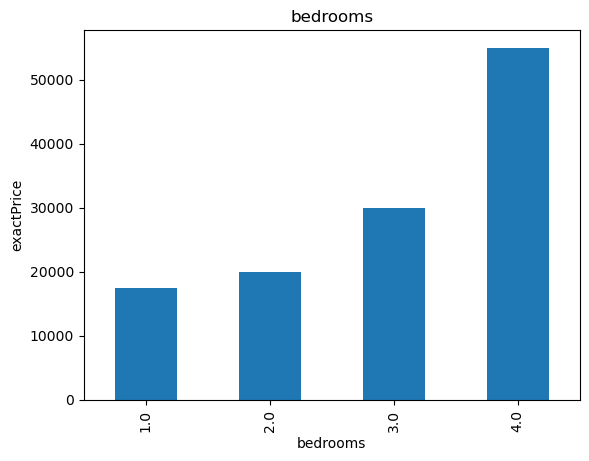

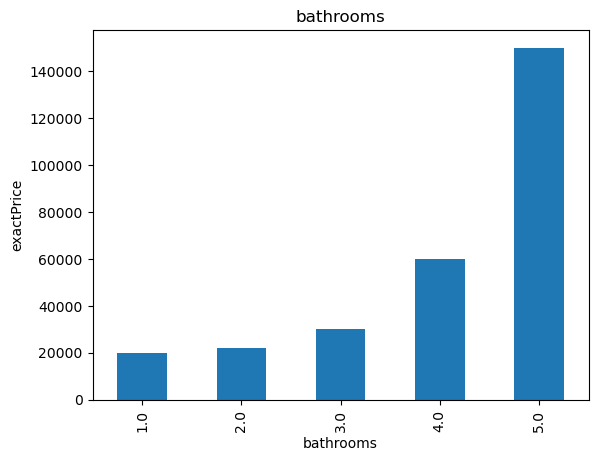

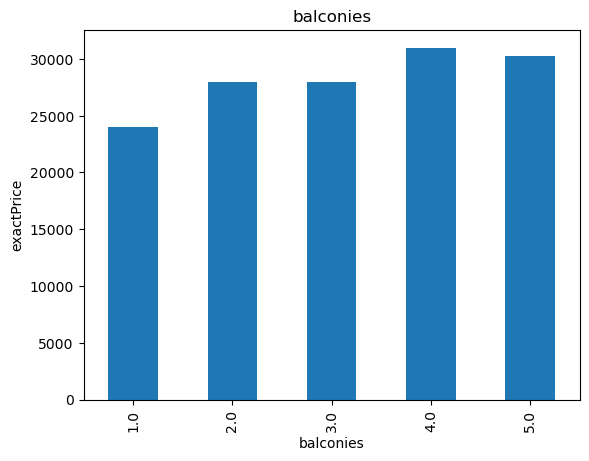

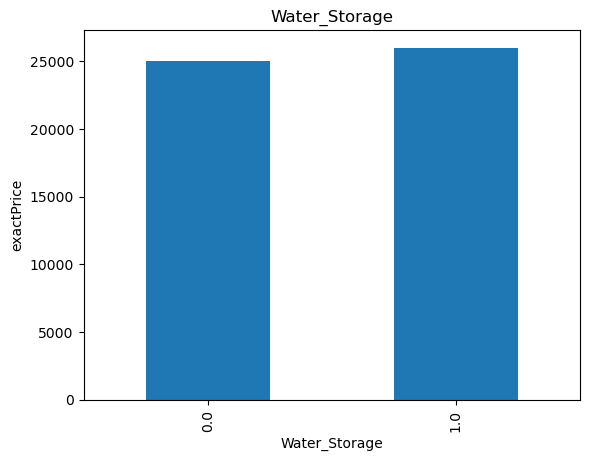

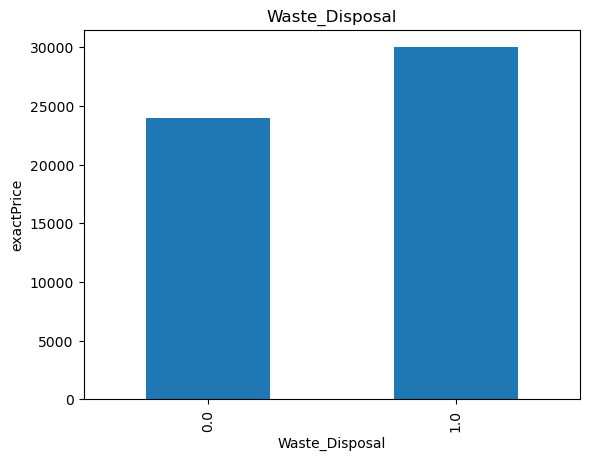

...

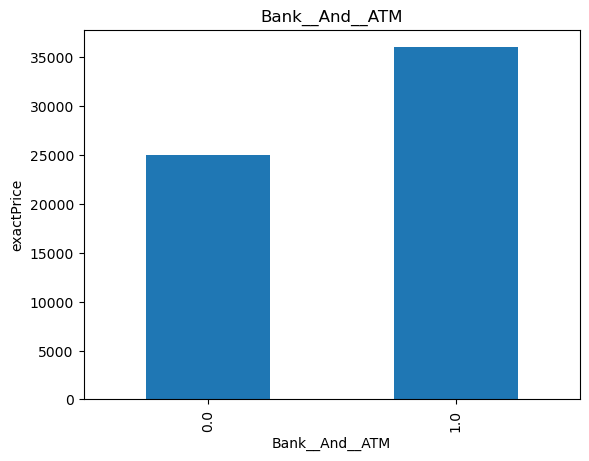

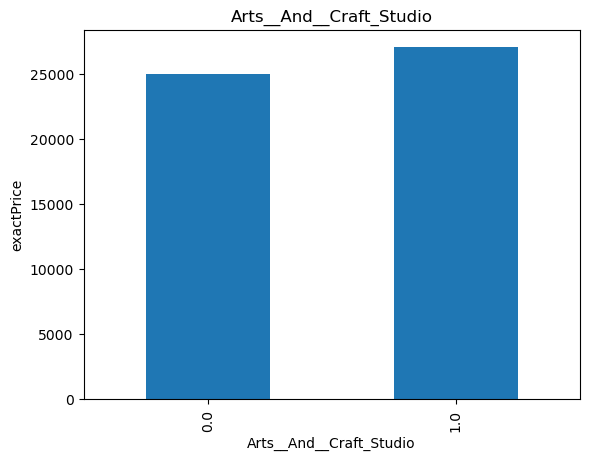

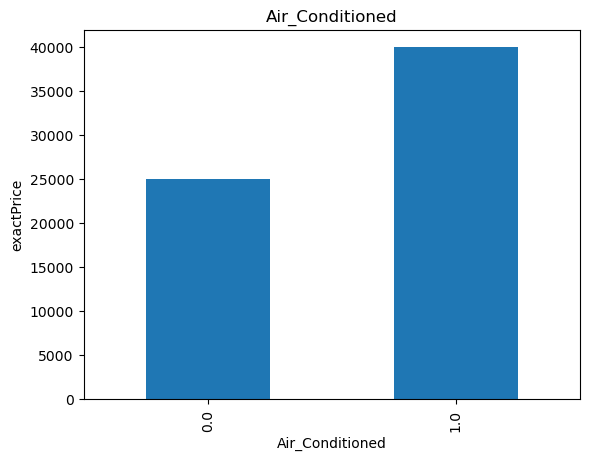

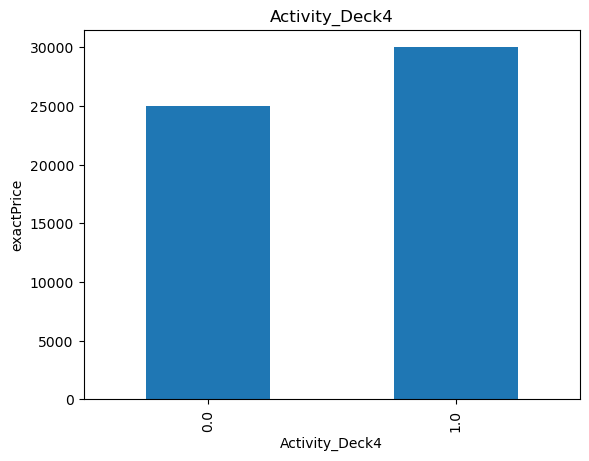

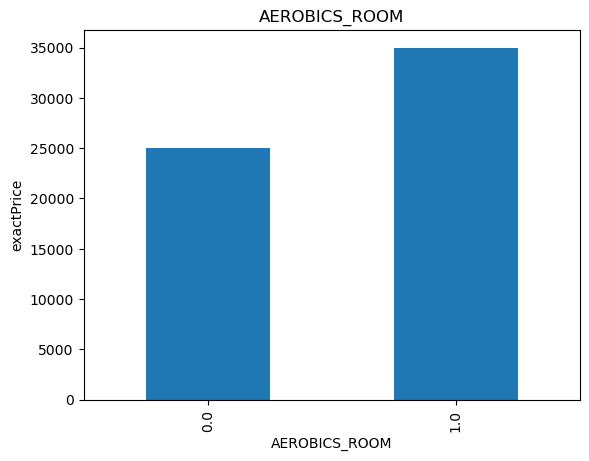

In [32]:
for feature in discrete_feature:
    data=dataset_dropped_na.copy()
    dataset_dropped_na.groupby(feature)['exactPrice'].median().plot.bar()
    plt.xlabel(feature)
    plt.ylabel('exactPrice')
    plt.title(feature)
    plt.show()

### Continuous Variable

In [33]:
continuous_feature=[feature for feature in numerical_features if feature not in discrete_feature]
print("Continuous feature Count {}".format(len(continuous_feature)))


Continuous feature Count 9


In [34]:
#  Removing Latitude and Longitude since their main significance is to explore data based on geolocation
continuous_feature.remove("Lat")
continuous_feature.remove("Long")

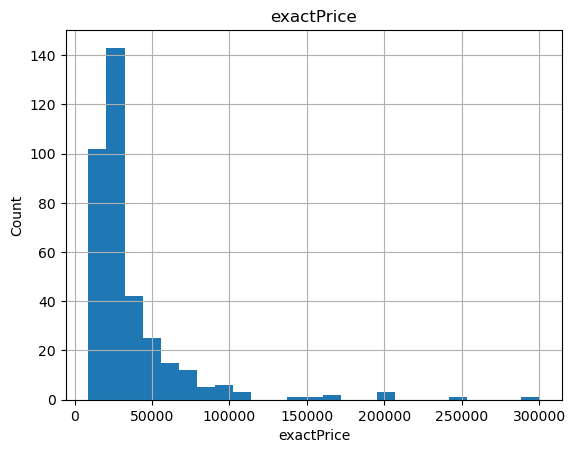

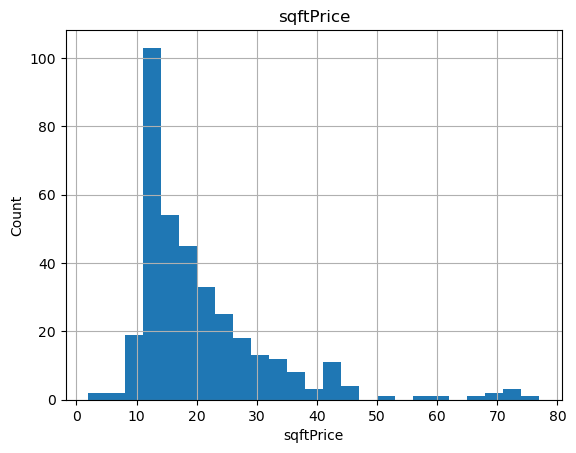

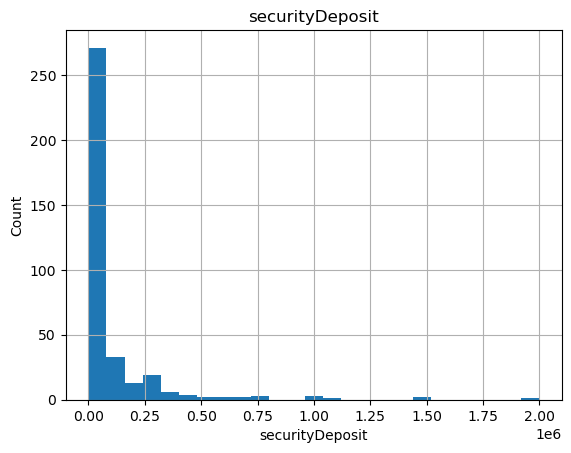

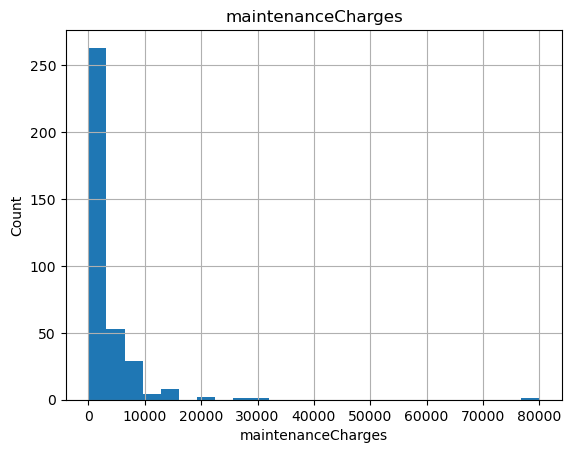

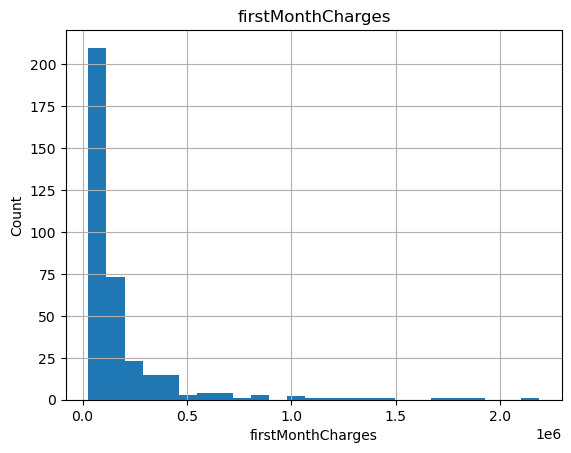

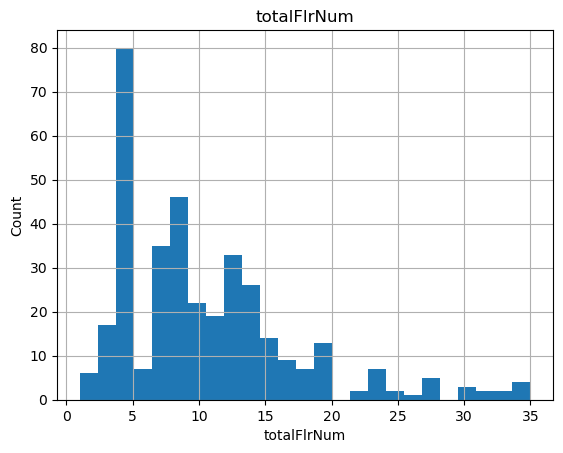

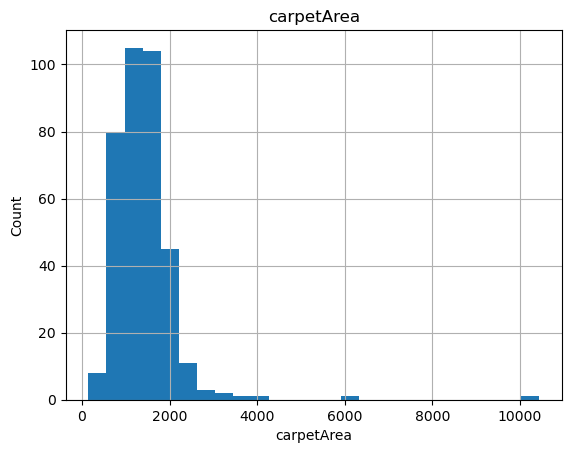

In [35]:
## Lets analyse the continuous values by creating histograms to understand the distribution

for feature in continuous_feature:
    data=dataset_dropped_na.copy()
    dataset_dropped_na[feature].hist(bins=25)
    plt.xlabel(feature)
    plt.ylabel("Count")
    plt.title(feature)
    plt.show()

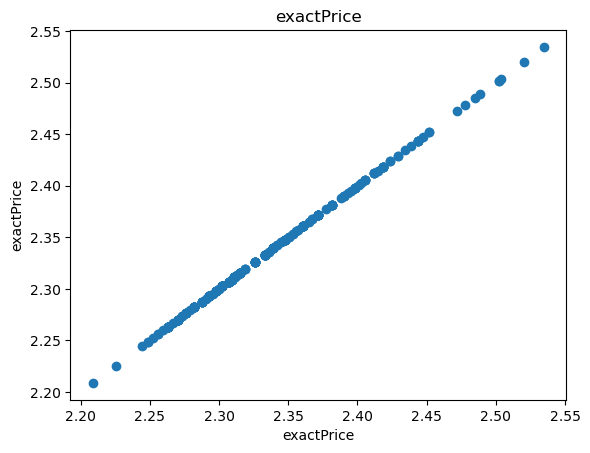

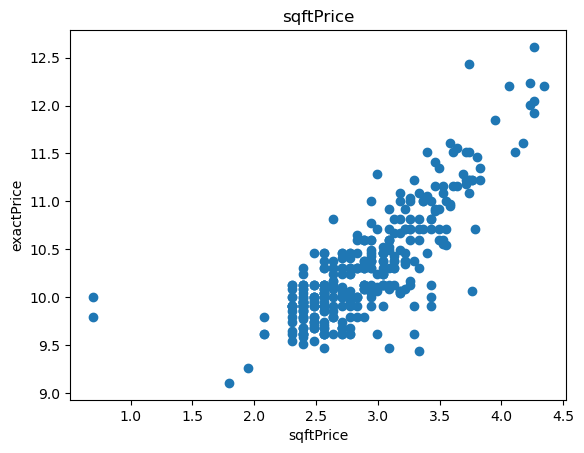

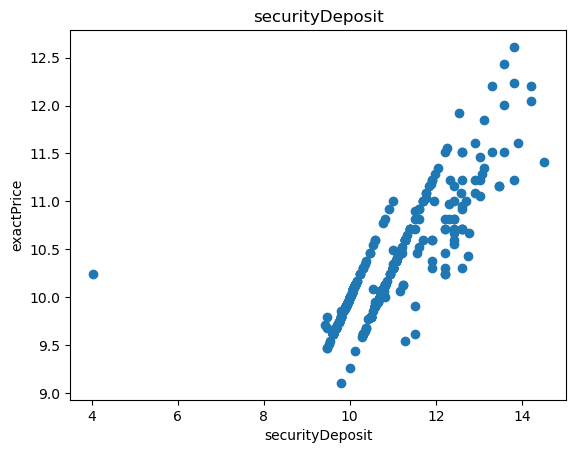

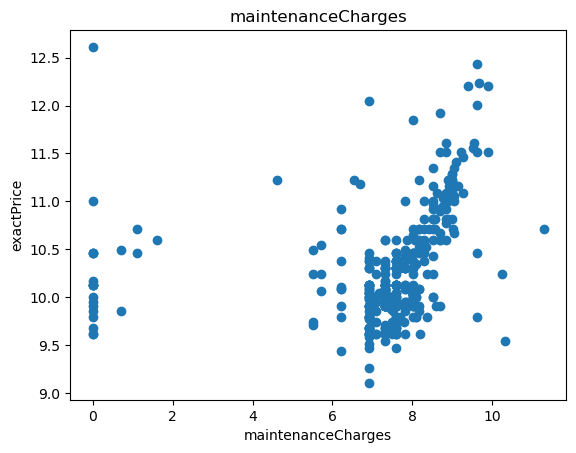

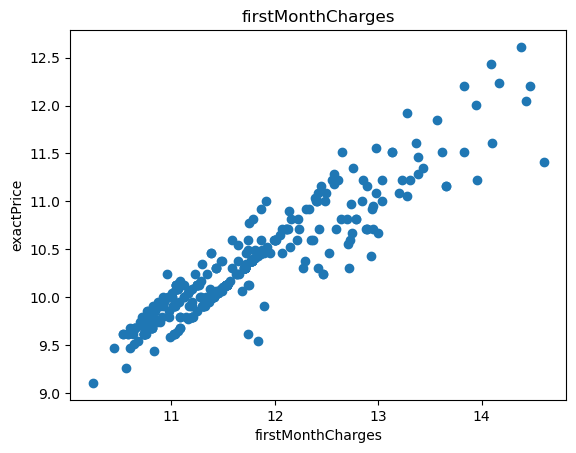

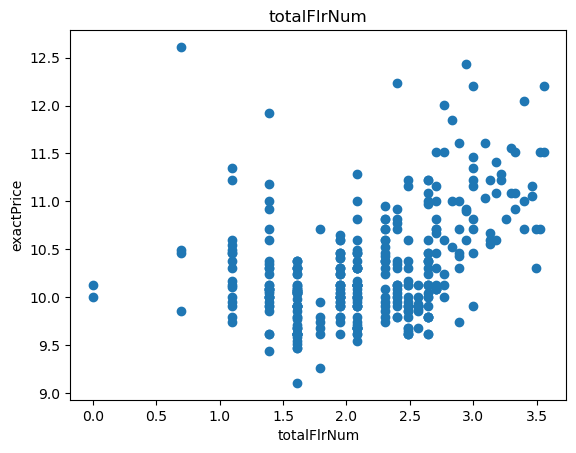

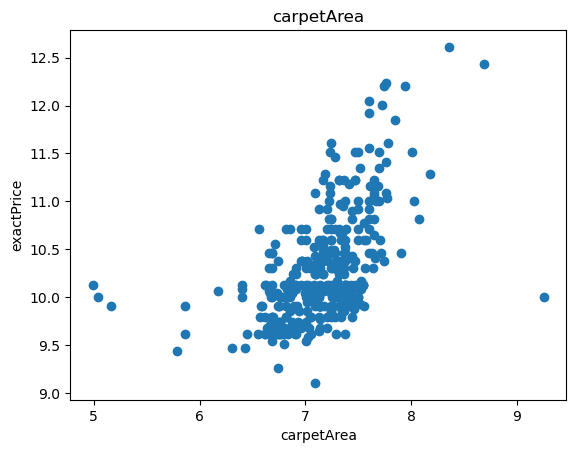

In [36]:
## We will be using logarithmic transformation


for feature in continuous_feature:
    data=dataset_dropped_na.copy()
    if 0 in data[feature].unique():
        pass
    else:
        data[feature]=np.log(data[feature])
        data['exactPrice']=np.log(data['exactPrice'])
        plt.scatter(data[feature],data['exactPrice'])
        plt.xlabel(feature)
        plt.ylabel('exactPrice')
        plt.title(feature)
        plt.show()


### 4. Outliers

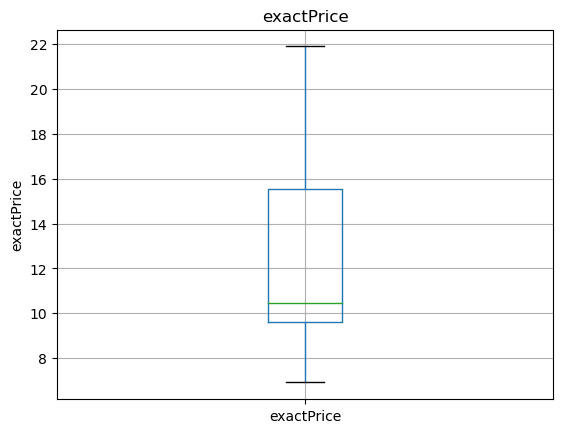

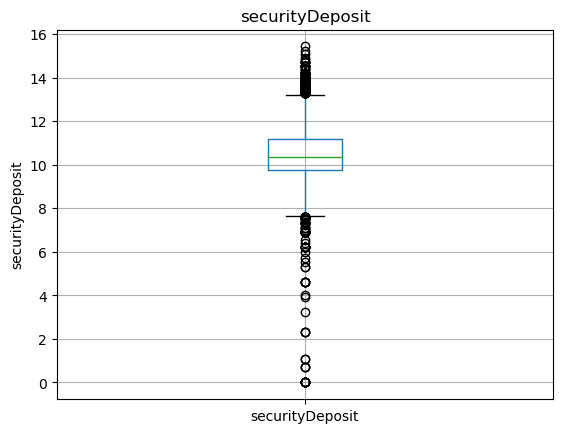

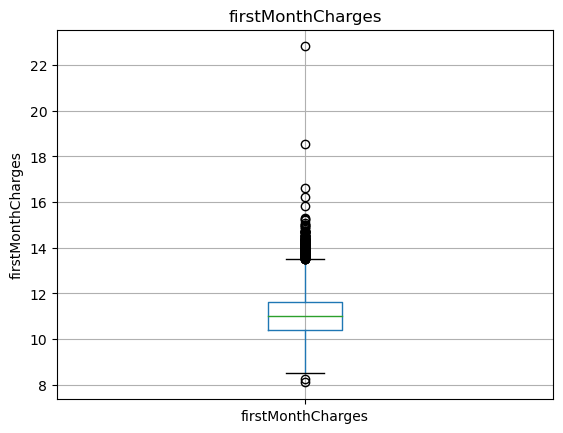

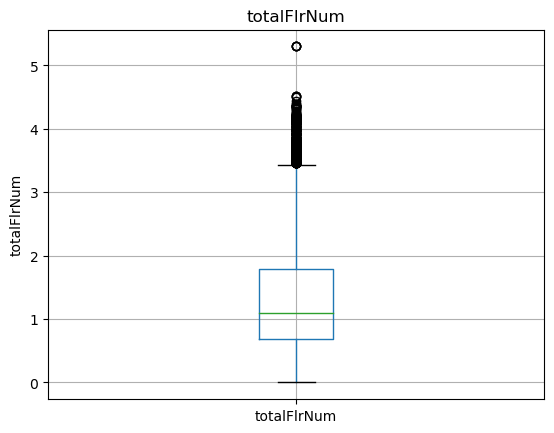

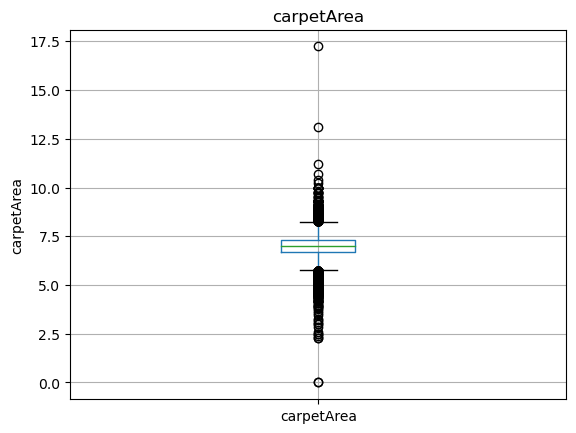

In [37]:
for feature in continuous_feature:
    data=dataset.copy()
    if 0 in data[feature].unique():
        pass
    else:
        data[feature]=np.log(data[feature])
        data.boxplot(column=feature)
        plt.ylabel(feature)
        plt.title(feature)
        plt.show()

### 5. Categorical Variables


In [38]:
categorical_features=[feature for feature in dataset_dropped_na.columns if dataset_dropped_na[feature].dtypes=='O']
categorical_features


['propertyType',
 'postedOn',
 'noOfLifts',
 'maintenanceChargesFrequency',
 'locality',
 'furnishing',
 'flrNum',
 'facing',
 'city',
 'brokerage',
 'URLs',
 'RentOrSale']

In [39]:
dataset_dropped_na[categorical_features].head()


,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,locality,furnishing,flrNum,facing,city,brokerage,URLs,RentOrSale
90,Multistorey Apartment,"May 20, '23",1,Monthly,Gandhinagar,Furnished,5,North - East,Gandhinagar,30 days,https://www.magicbricks.com/propertyDetails/2-...,Rent
177,Multistorey Apartment,"May 20, '23",1,Monthly,Sargasan,Unfurnished,1,North - East,Gandhinagar,30 days,https://www.magicbricks.com/propertyDetails/2-...,Rent
183,Multistorey Apartment,"May 20, '23",1,Monthly,Gandhinagar,Furnished,2,North - East,Gandhinagar,30 days,https://www.magicbricks.com/propertyDetails/2-...,Rent
190,Multistorey Apartment,"May 20, '23",1,Monthly,Gandhinagar,Furnished,2,North - East,Gandhinagar,30 days,https://www.magicbricks.com/propertyDetails/3-...,Rent
192,Multistorey Apartment,"May 21, '23",1,Monthly,Sargasan,Unfurnished,5,North - East,Gandhinagar,30 days,https://www.magicbricks.com/propertyDetails/2-...,Rent


In [40]:
for feature in categorical_features:
    print('The feature is {} and number of categories are {}'.format(feature,len(dataset_dropped_na[feature].unique())))


The feature is propertyType and number of categories are 3
The feature is postedOn and number of categories are 54
The feature is noOfLifts and number of categories are 9
The feature is maintenanceChargesFrequency and number of categories are 2
The feature is locality and number of categories are 114
The feature is furnishing and number of categories are 3
The feature is flrNum and number of categories are 28
The feature is facing and number of categories are 8
The feature is city and number of categories are 13
The feature is brokerage and number of categories are 6
The feature is URLs and number of categories are 362
The feature is RentOrSale and number of categories are 1


### Since I don't intend to explore the below features, I am deleting these

In [41]:
categorical_features.remove("postedOn")
categorical_features.remove("locality")
categorical_features.remove("URLs")
categorical_features.remove("RentOrSale")

### 6. Cardinality of Categorical Variables

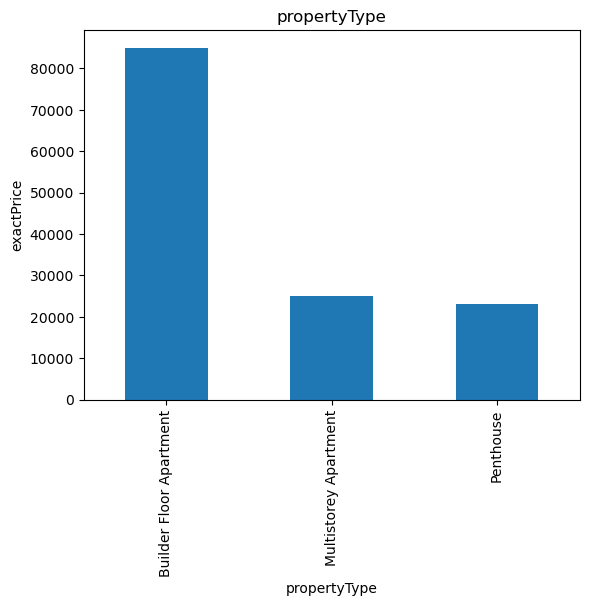

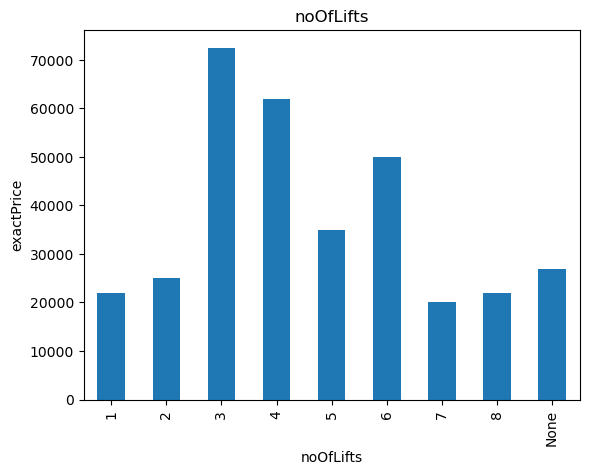

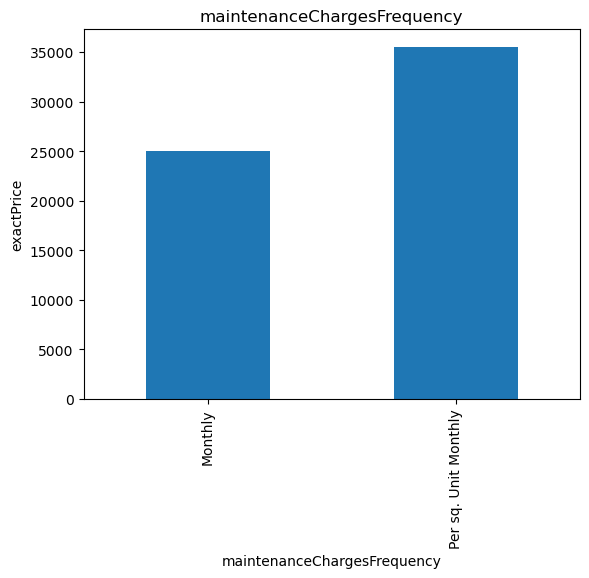

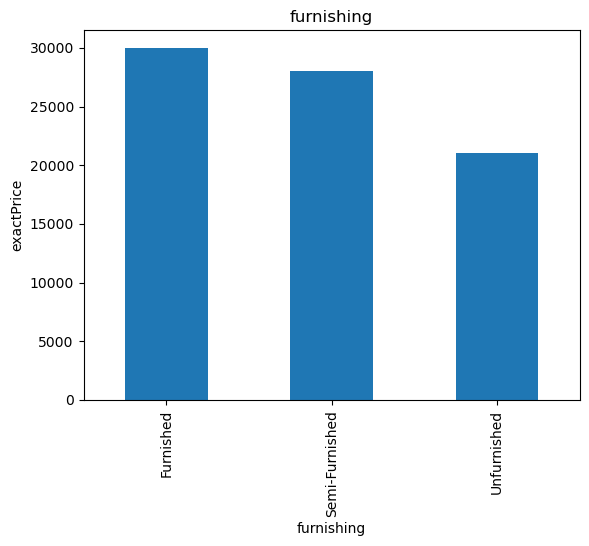

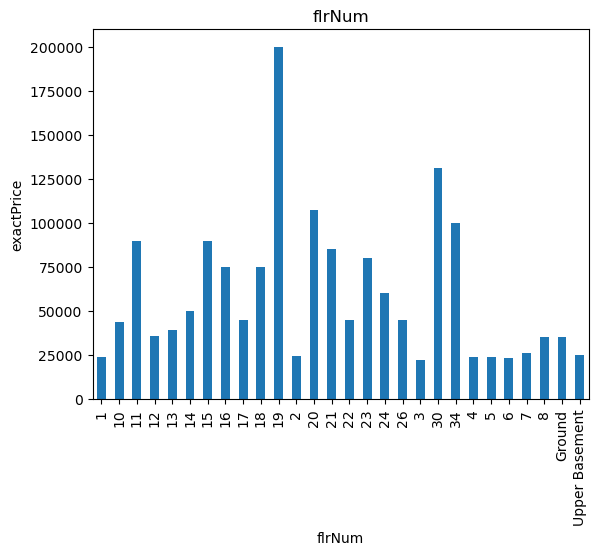

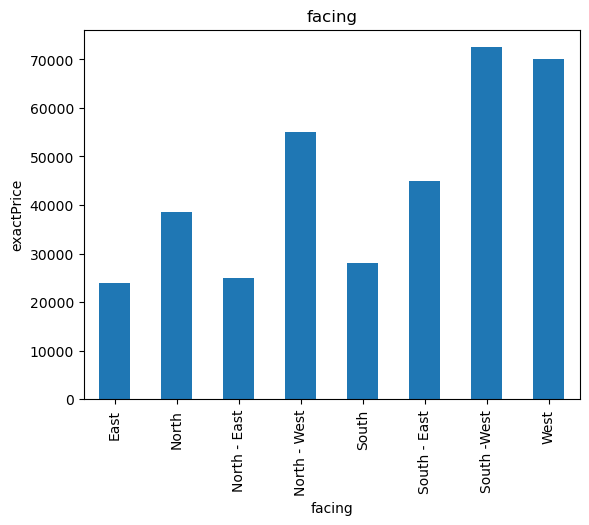

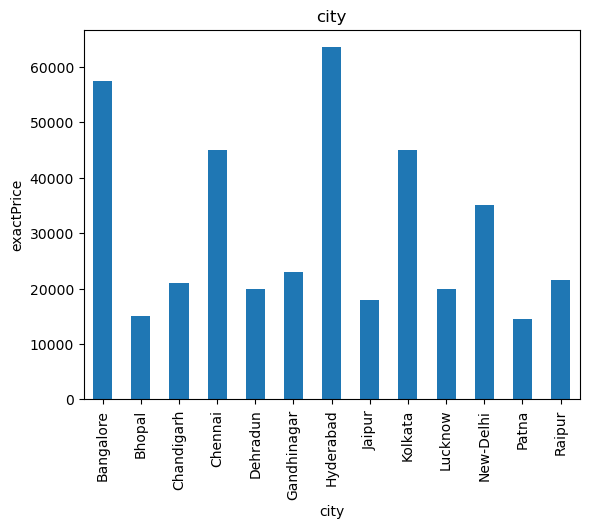

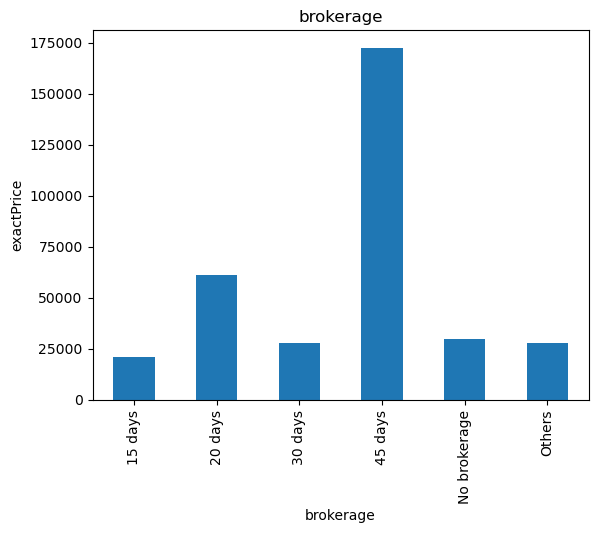

In [42]:
for feature in categorical_features:
    data=dataset_dropped_na.copy()
    data.groupby(feature)['exactPrice'].median().plot.bar()
    plt.xlabel(feature)
    plt.ylabel('exactPrice')
    plt.title(feature)
    plt.show()

### 7. Mapping data as per their Longitude and Latitude

In [43]:
def preprocess_for_map(df) :
    df = df[['locality','Lat','Long','exactPrice',"city"]]
    # df = df.replace('NA', np.nan)
    df.dropna(subset=['Lat'], inplace=True)
    df.dropna(subset=['exactPrice'], inplace=True)
    df["Lat"] = df["Lat"].astype(float)
    df["Long"] = df["Long"].astype(float)
    return df


map_data = preprocess_for_map(dataset)

/tmp/ipykernel_31/3529361060.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(subset=['Lat'], inplace=True)
/tmp/ipykernel_31/3529361060.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(subset=['exactPrice'], inplace=True)
/tmp/ipykernel_31/3529361060.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Lat"] = df["Lat"].astype(float)
/tmp/ipykernel_3

In [44]:
map_data[['Lat','Long','exactPrice',"city"]]

,Lat,Long,exactPrice,city
0,25.605898,85.056330,240000.0,Patna
2,25.621426,85.079964,17000.0,Patna
3,25.593090,85.185006,5000.0,Patna
4,25.593090,85.185005,12000.0,Patna
5,25.605076,85.144040,18000.0,Patna
...,...,...,...,...
27895,30.314961,78.056634,20227500.0,Dehradun
27896,30.370890,78.081697,6933500.0,Dehradun
27897,30.354673,78.077240,9000000.0,Dehradun
27898,30.354086,78.082277,7645000.0,Dehradun


In [45]:
city_map = folium.Map(location=[21, 78], zoom_start=11.2, tiles='Stamen Terrain')
mc = MarkerCluster()
for idx, row in map_data.iterrows():
    if not math.isnan(row['Long']) and not math.isnan(row['Lat']):
        popup = """
        Locality : <b>%s</b><br>
        Price : <b>%s</b><br>
        city : <b>%s</b><br>
        """ % (row['locality'], row['exactPrice'],row["city"])
        mc.add_child(Marker([row['Lat'], row['Long']],tooltip=popup))
    city_map.add_child(mc)
city_map

# Initiation of Step 3

### Uptil now we have explored data with no null value in all the 90 features. But this resulted into very low amount of data to explore
##### Now we are going to choose specific columns to drop the null values and for important features we would fill the null values to explore wider rande of data
##### Since the exactPrice of properties for Sale would be very high than that of rent, I am seperating the the dataset on rent or sale to get a better look in the characteristics of the features

### Since Rent or Sale feature has very low null values 0.11%, I have decided to drop it from features_with_na and drop null values in dataset for smoother analysis

In [46]:
### Removing from features_with_na list

features_with_na.remove("RentOrSale")
features_with_na.remove("URLs")

### dropiing the features from the dataset

dataset = dataset.dropna(subset = ["RentOrSale"])
dataset = dataset.dropna(subset = ["URLs"])

#### Making an empty set to append all the important features/ those features where Null values scored more than the not Null values, Since those features are important and should not be droped the null values right away

#### Initializing a set of important features

In [47]:
impFea =set()

In [48]:
type(impFea)

set

### Here we check If the null values in any any feature correlates to higher exactPrice and store them in a set for further analysis

sqftPrice 13.19  % missing values


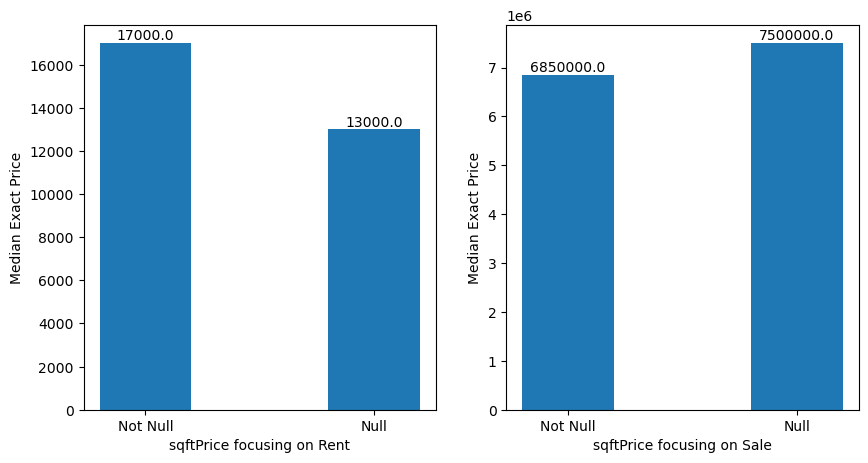

securityDeposit 69.72  % missing values


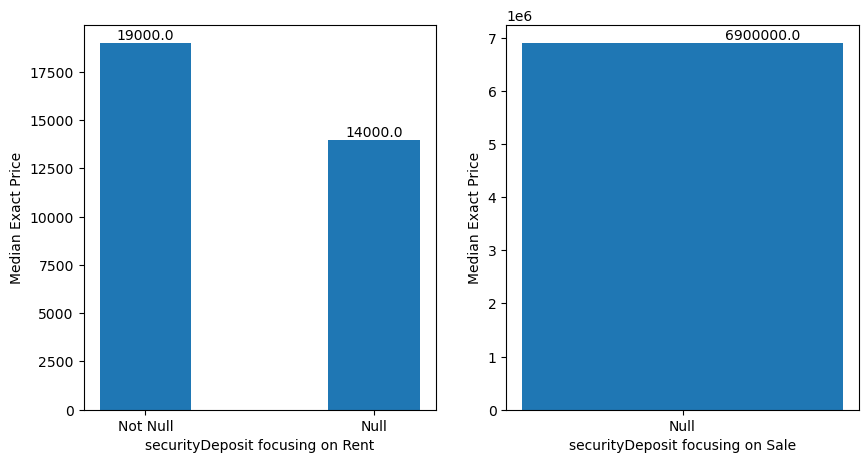

noOfLifts 82.34  % missing values


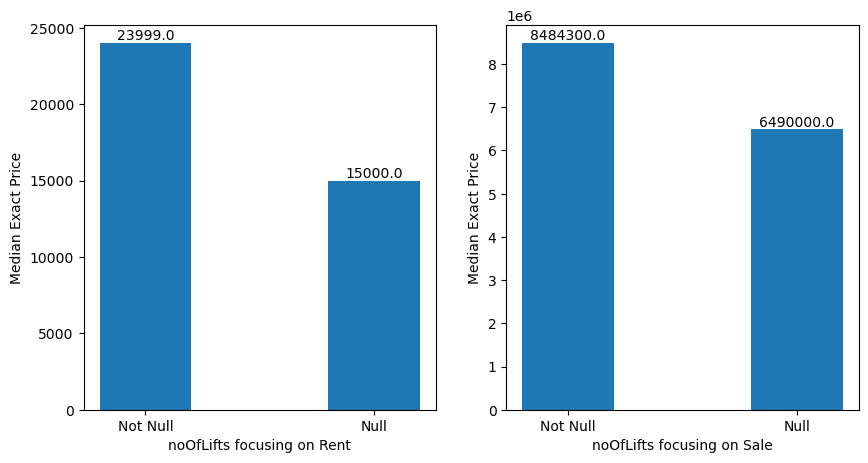

maintenanceChargesFrequency 76.37  % missing values


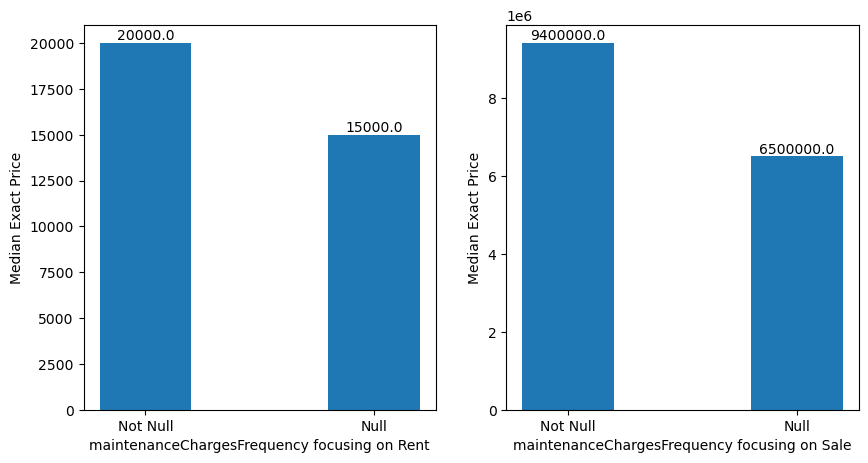

maintenanceCharges 83.82  % missing values


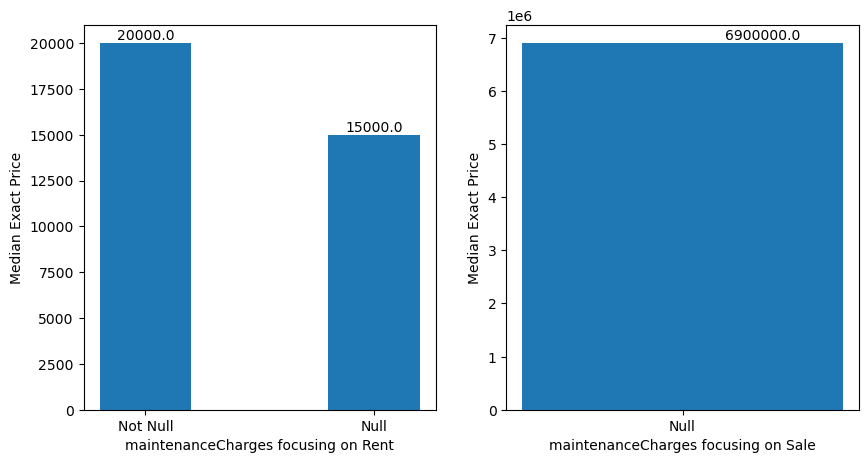

locality 8.05  % missing values


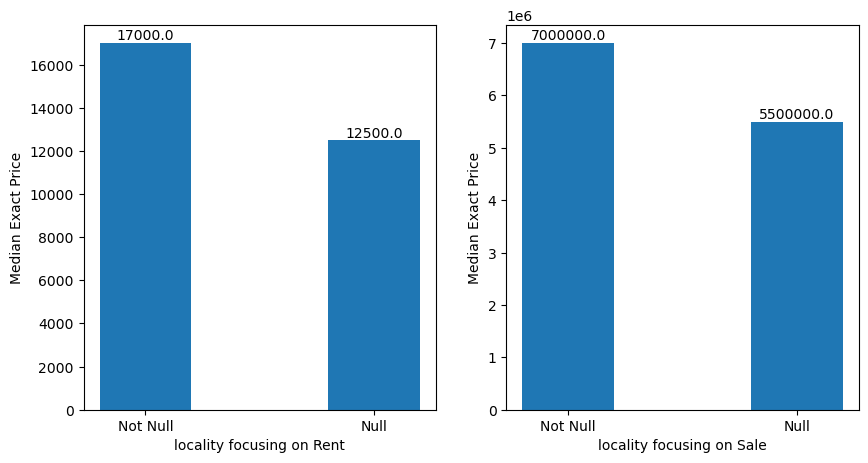

furnishing 2.4299999999999997  % missing values


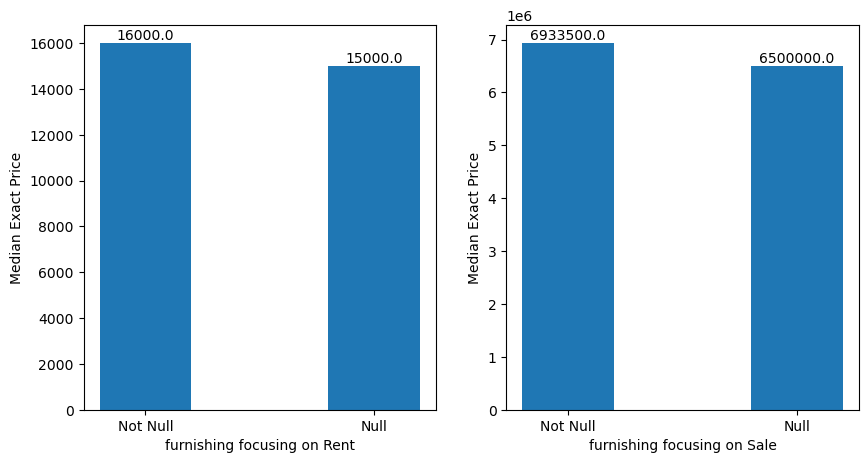

flrNum 24.04  % missing values


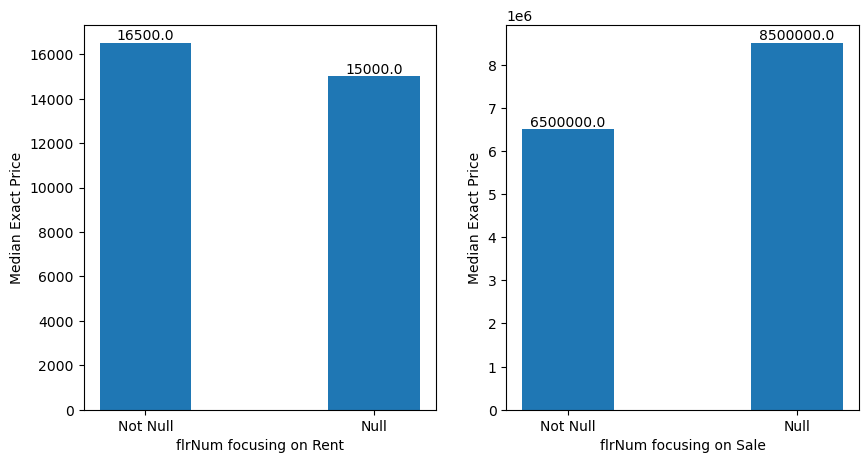

firstMonthCharges 68.19  % missing values


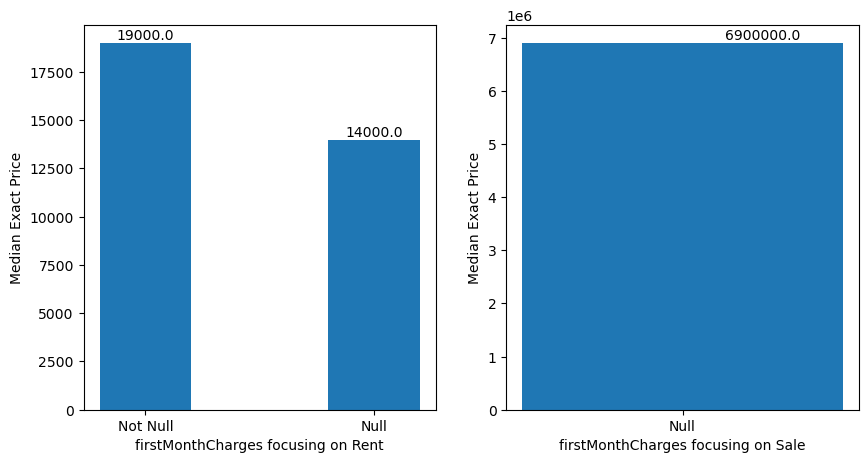

facing 52.449999999999996  % missing values


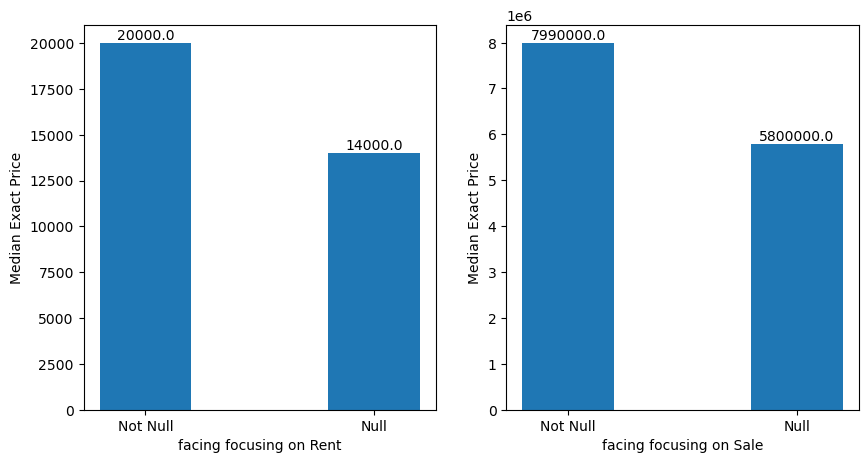

totalFlrNum 8.0  % missing values


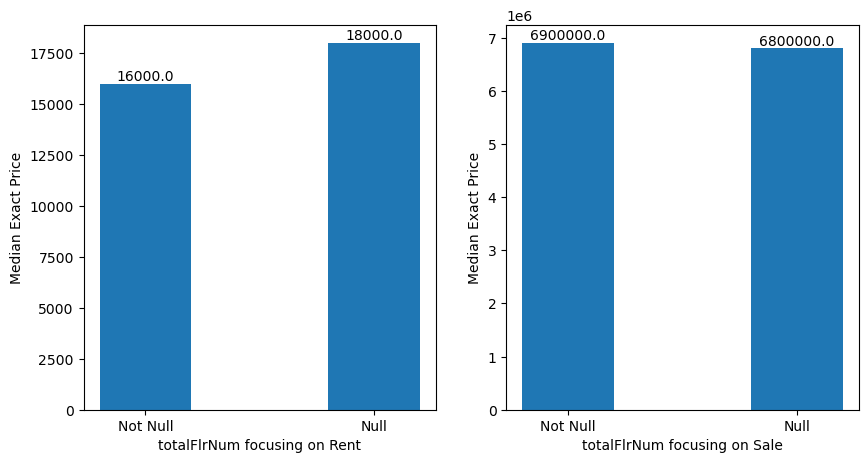

carpetArea 46.33  % missing values


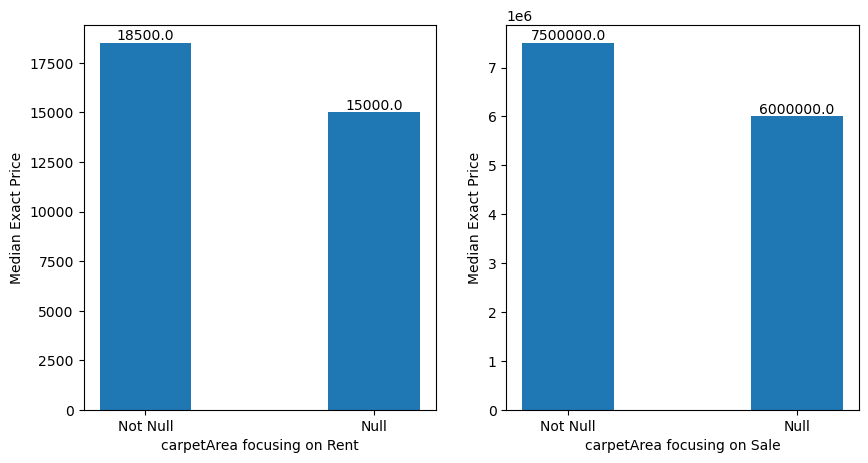

brokerage 79.27  % missing values


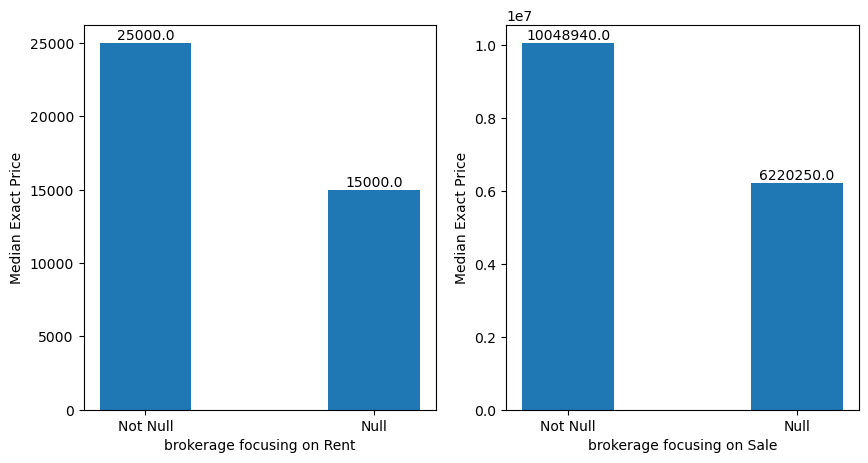

bedrooms 2.11  % missing values


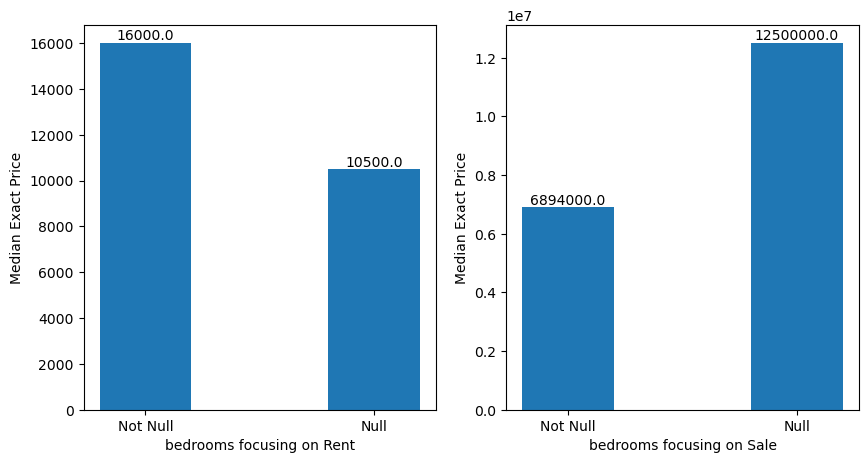

bathrooms 2.6100000000000003  % missing values


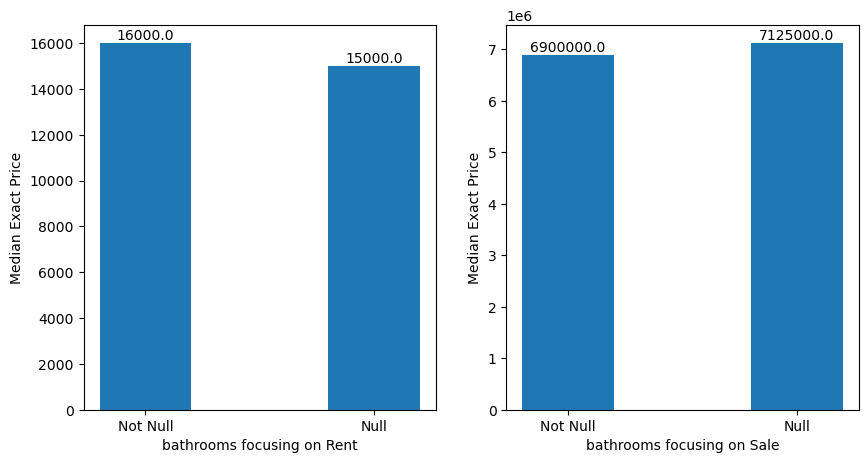

balconies 38.83  % missing values


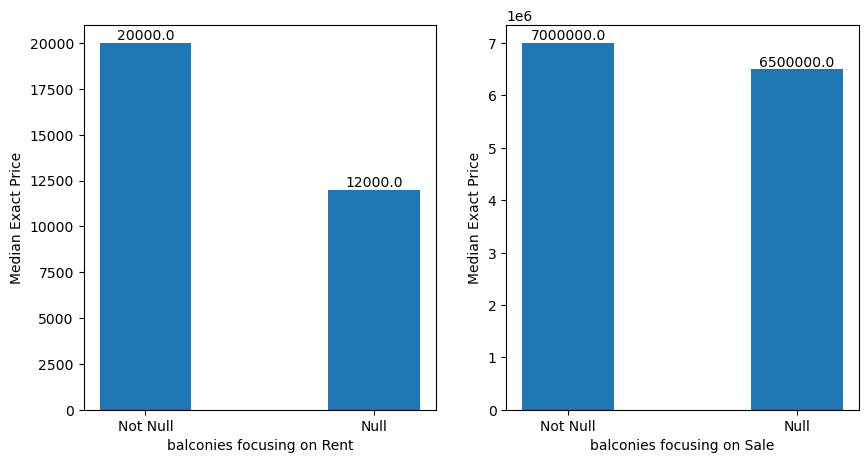

Water_Storage 79.07  % missing values


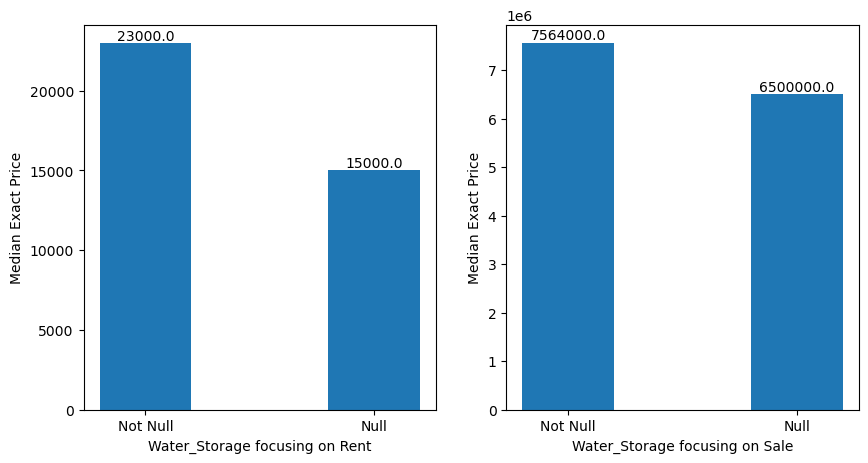

Waste_Disposal 79.07  % missing values


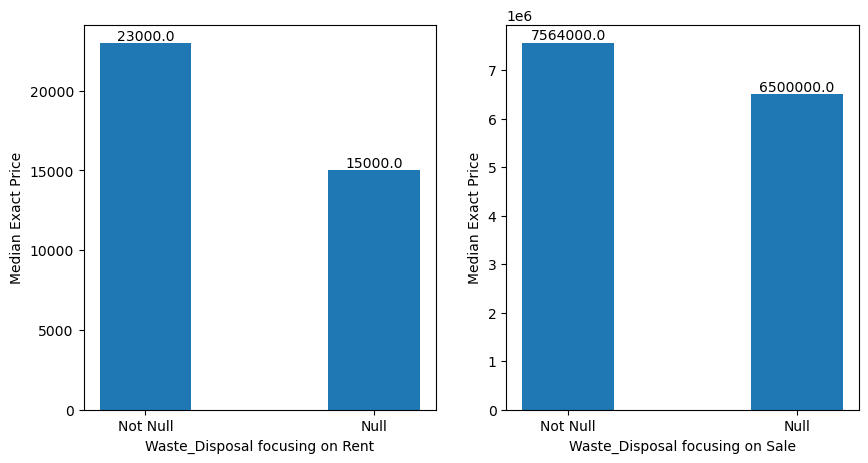

Visitor_Parking 79.07  % missing values


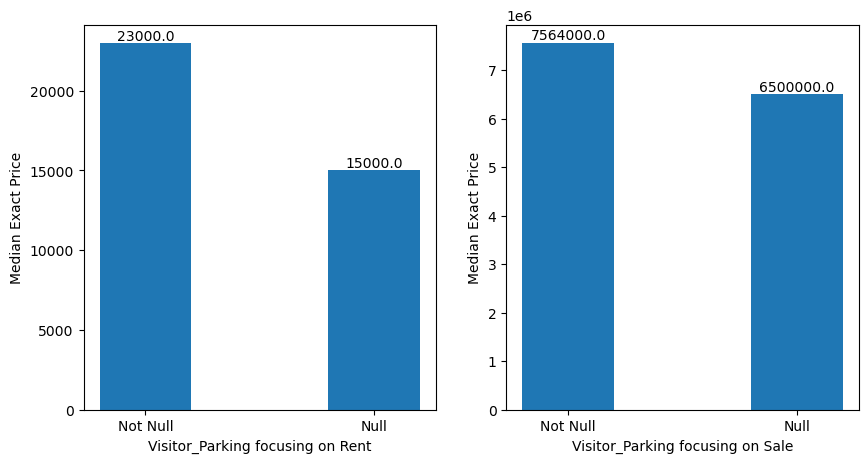

Vaastu_Compliant 79.07  % missing values


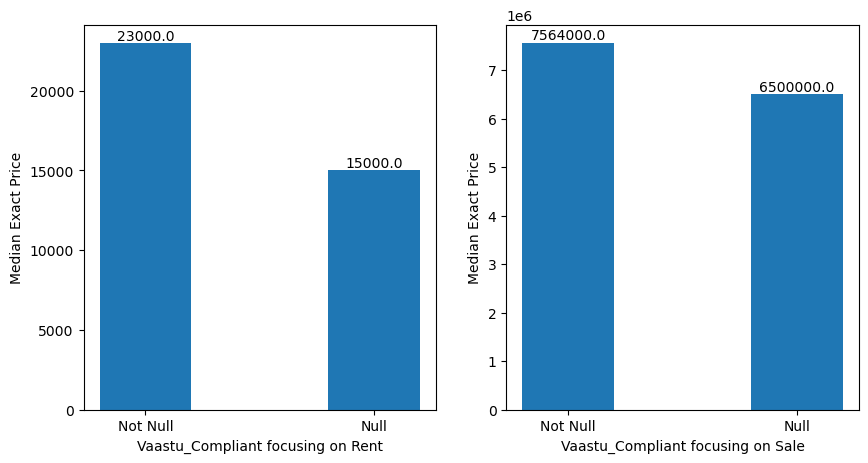

Swimming_Pool 79.07  % missing values


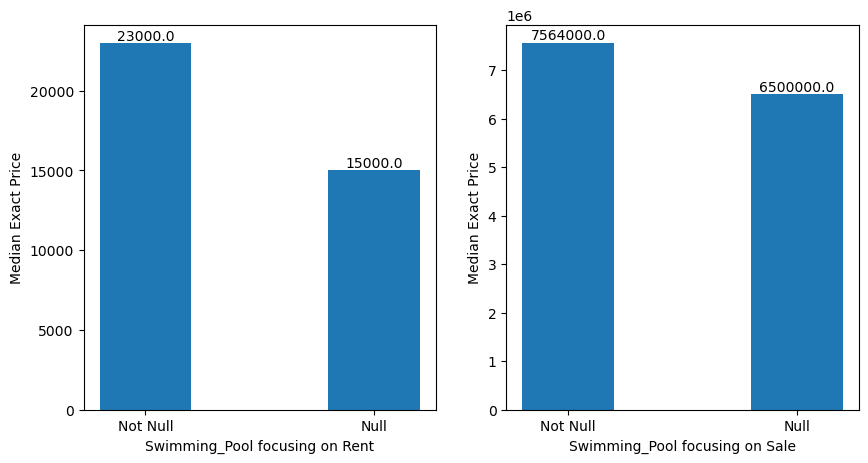

Skydeck 79.07  % missing values


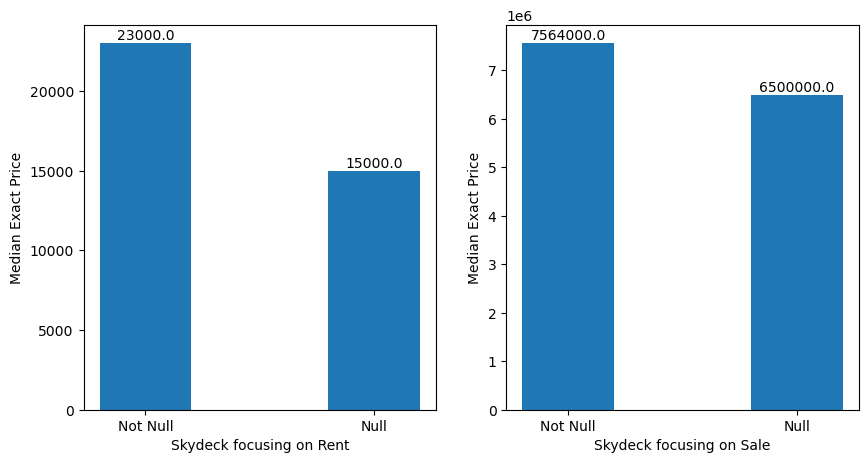

Service_Or_Goods_Lift 79.07  % missing values


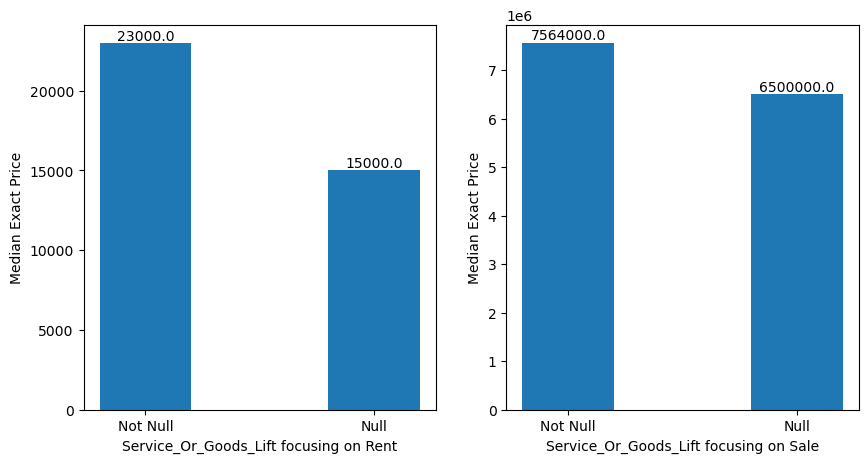

Security 79.07  % missing values


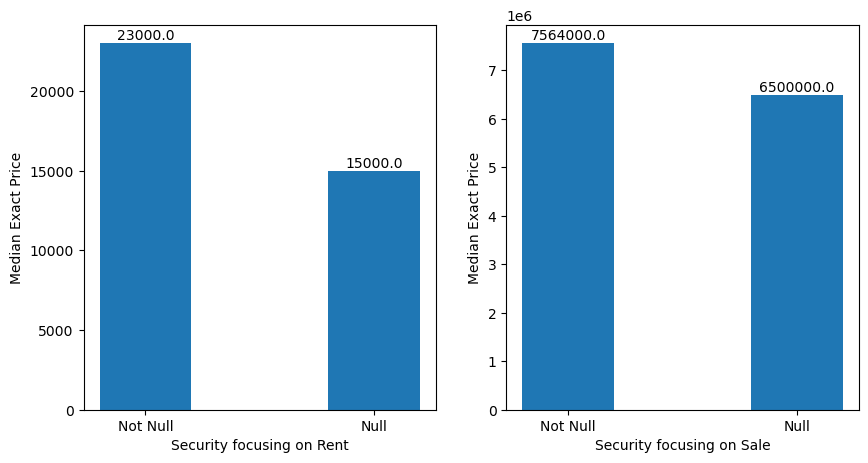

Retail_Boulevard___Retail_Shops__ 79.07  % missing values


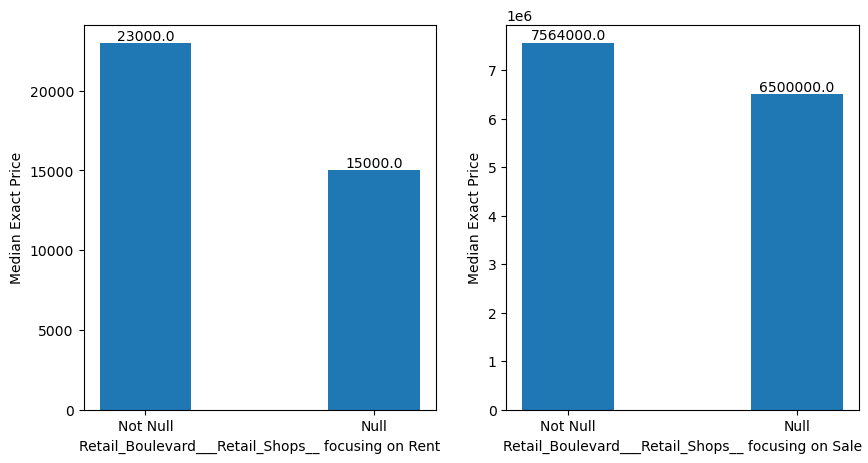

Reserved_Parking 79.07  % missing values


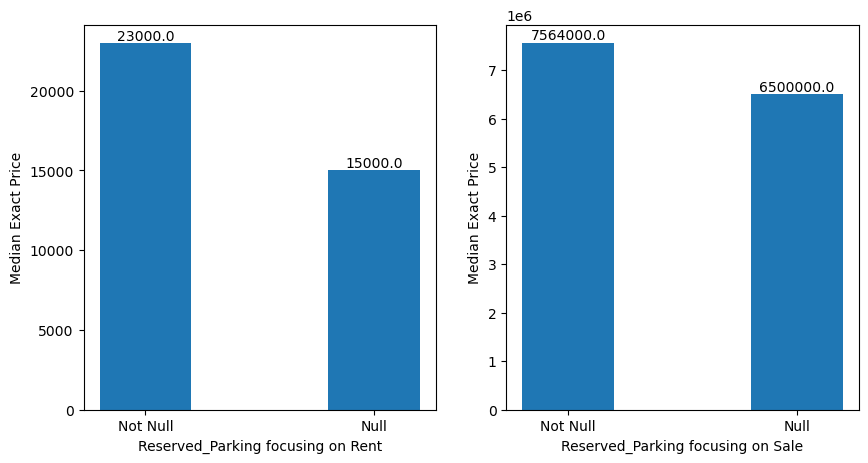

Rentable_Community_Space 79.07  % missing values


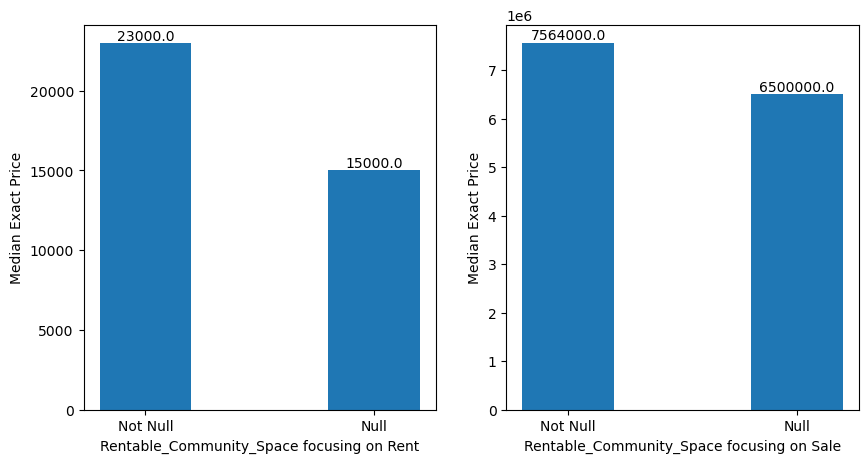

Recreational_Pool 79.07  % missing values


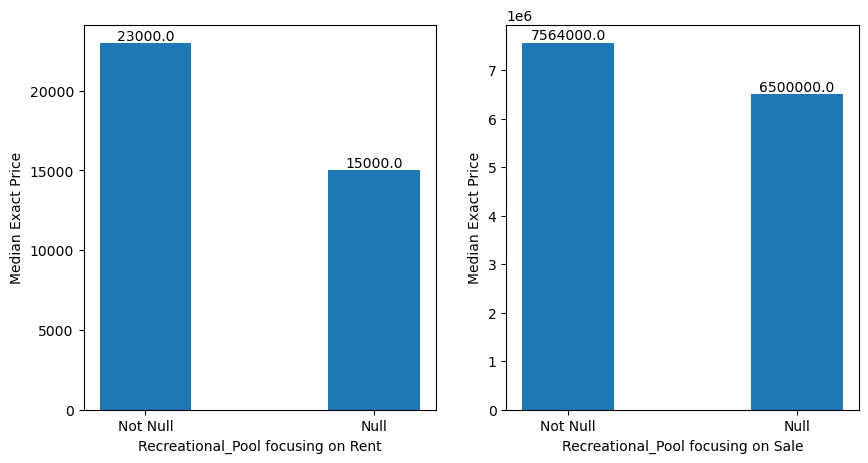

Rain_Water_Harvesting 79.07  % missing values


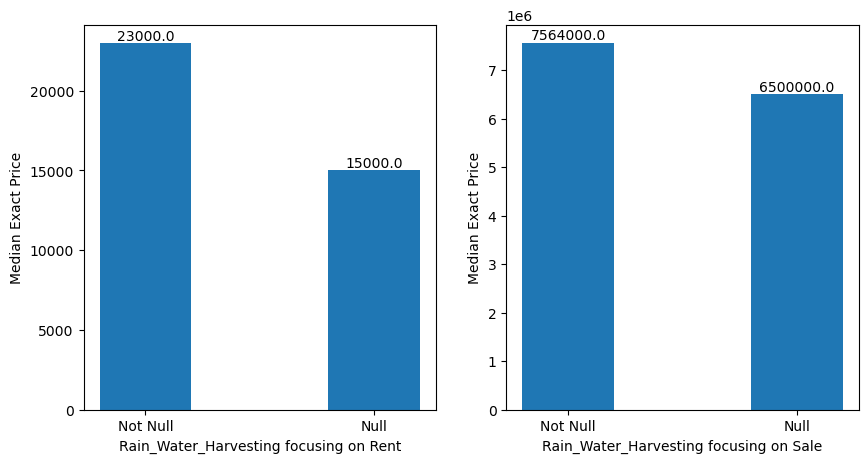

RO_Water_System 79.07  % missing values


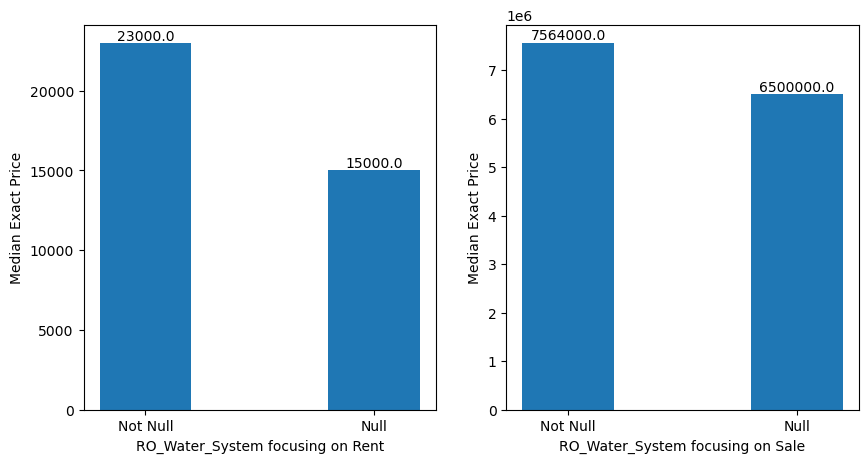

Private_Terrace_Or_Garden 79.07  % missing values


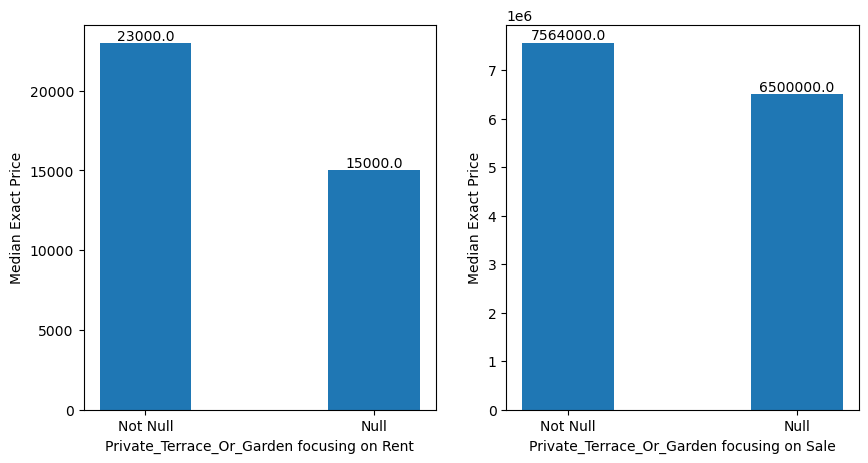

Private_Garden 79.07  % missing values


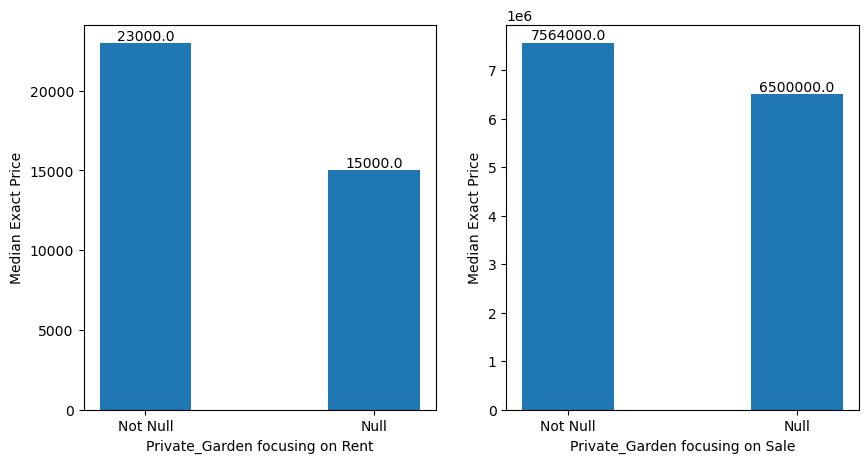

Power_Back_Up 79.07  % missing values


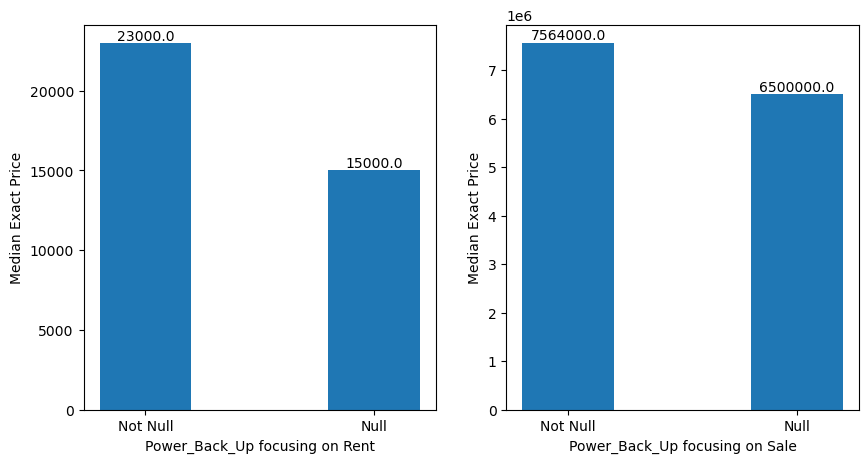

Piped_Gas 79.07  % missing values


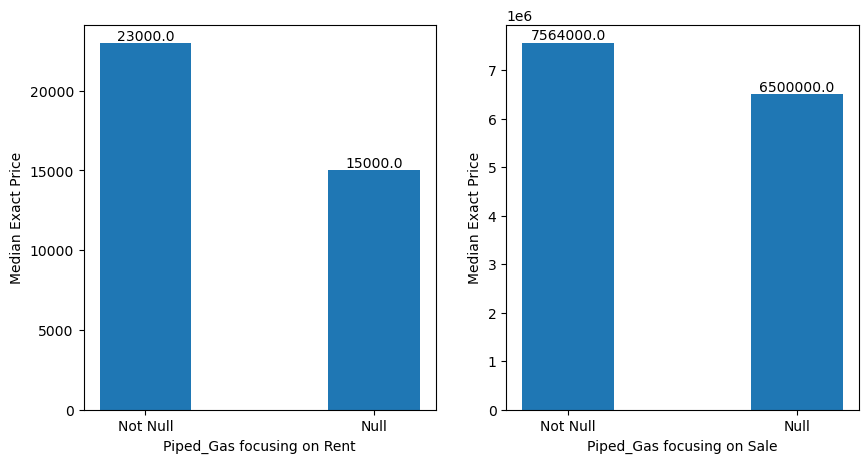

Park 79.07  % missing values


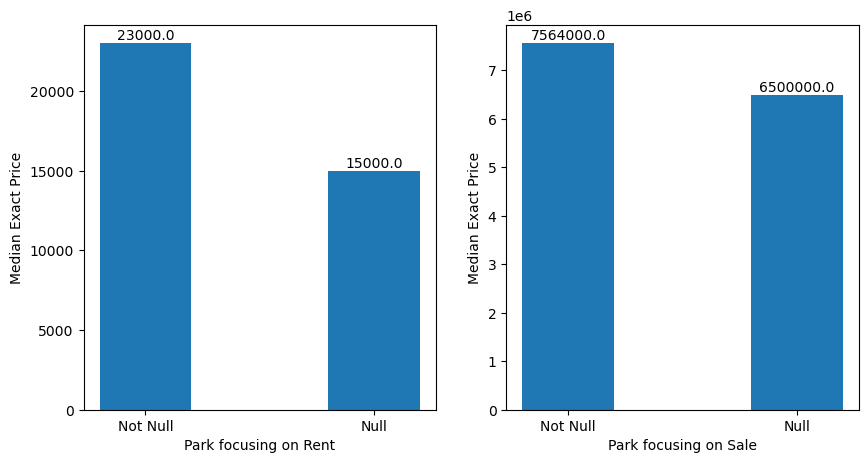

Outdoor_Tennis_Courts 79.07  % missing values


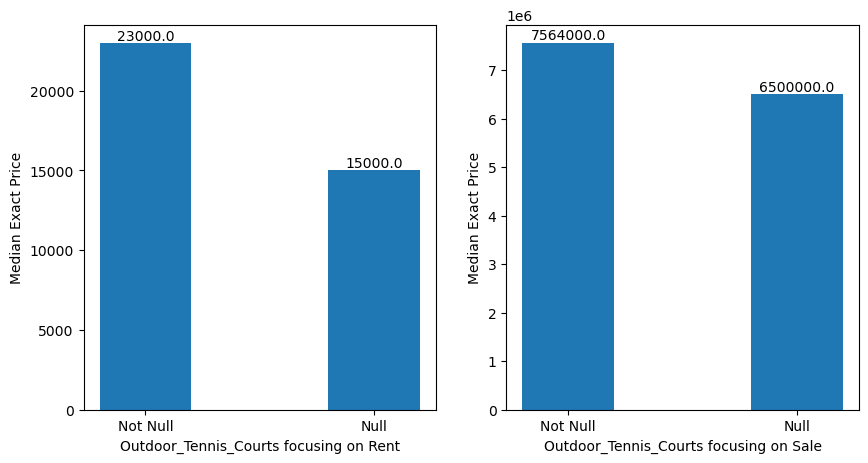

Multipurpose_Hall 79.07  % missing values


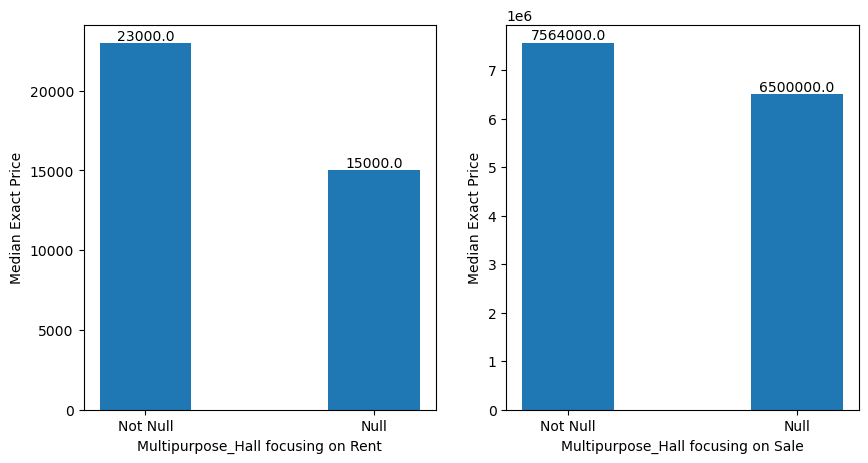

Multipurpose_Courts 79.07  % missing values


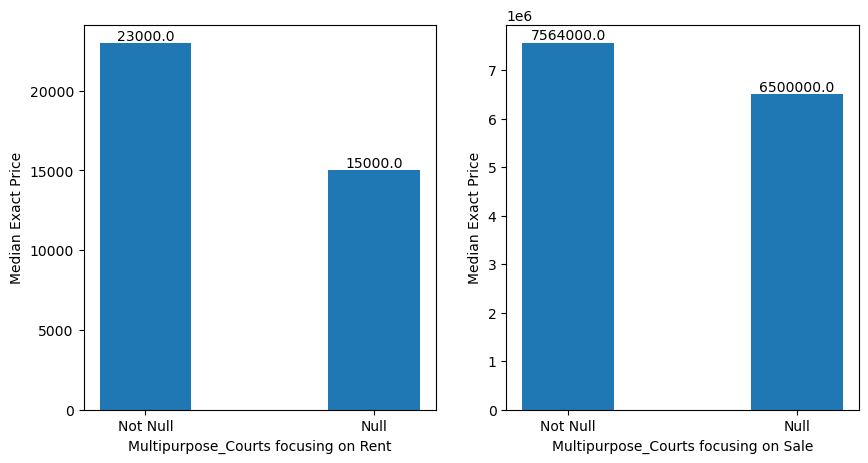

Mini_Cinema_Theatre 79.07  % missing values


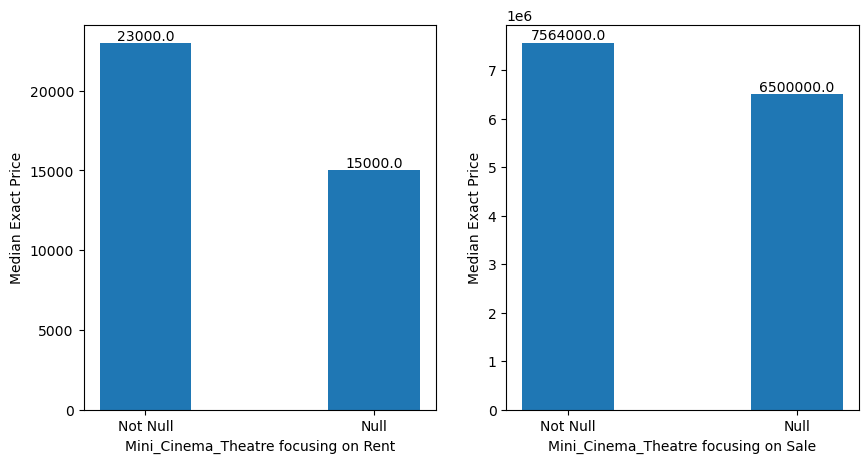

Meditation_Area 79.07  % missing values


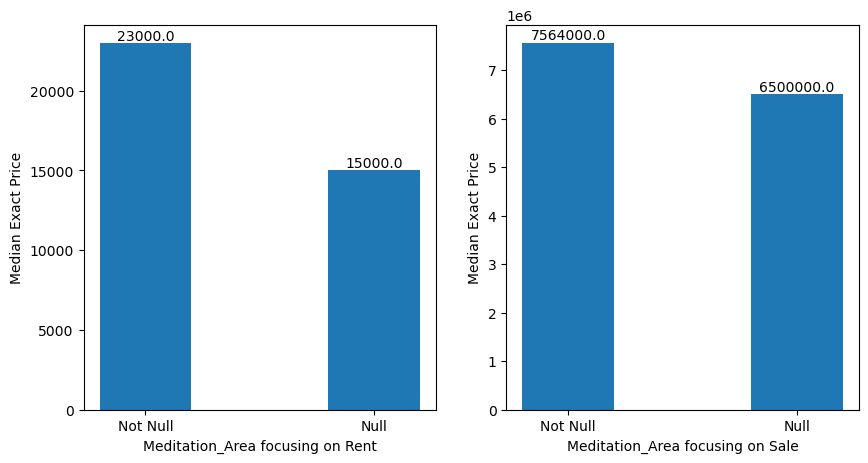

Maintenance_Staff 79.07  % missing values


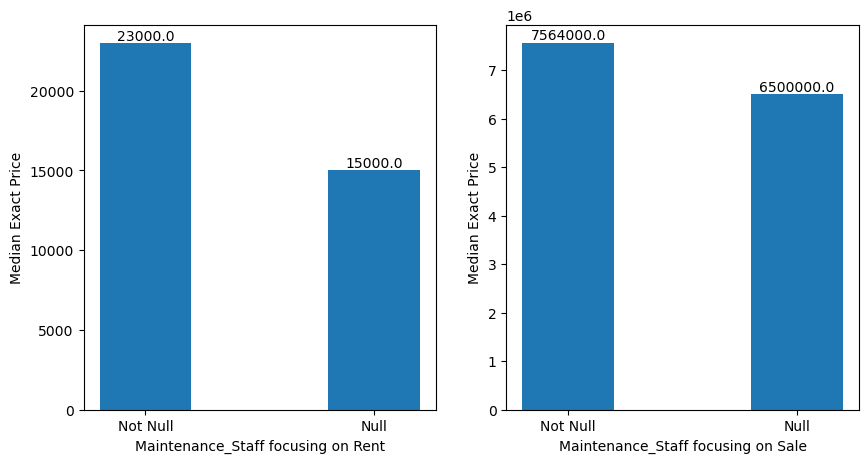

Long 7.7700000000000005  % missing values


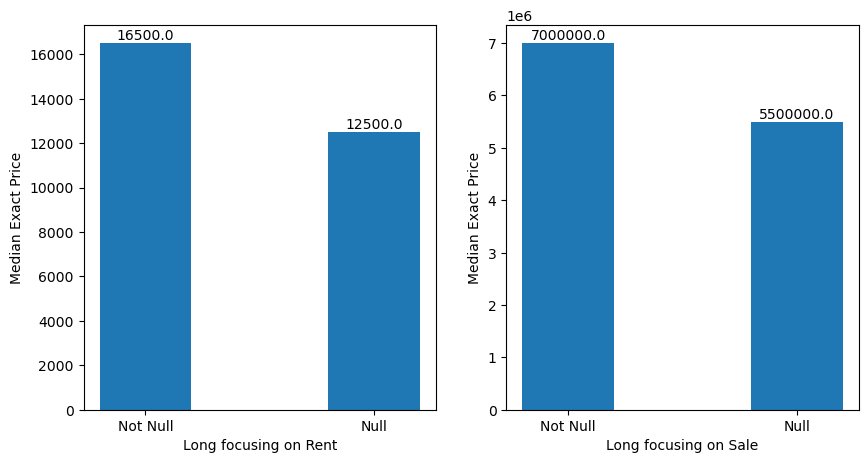

Lift 79.07  % missing values


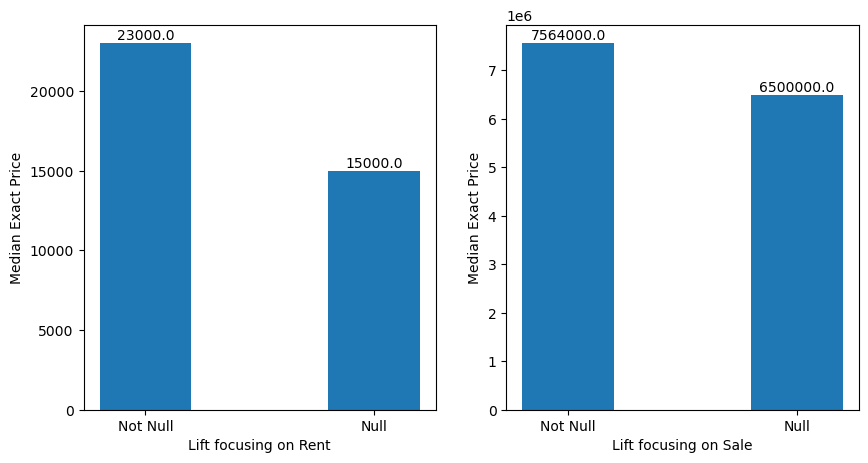

Library_And_Business_Centre 79.07  % missing values


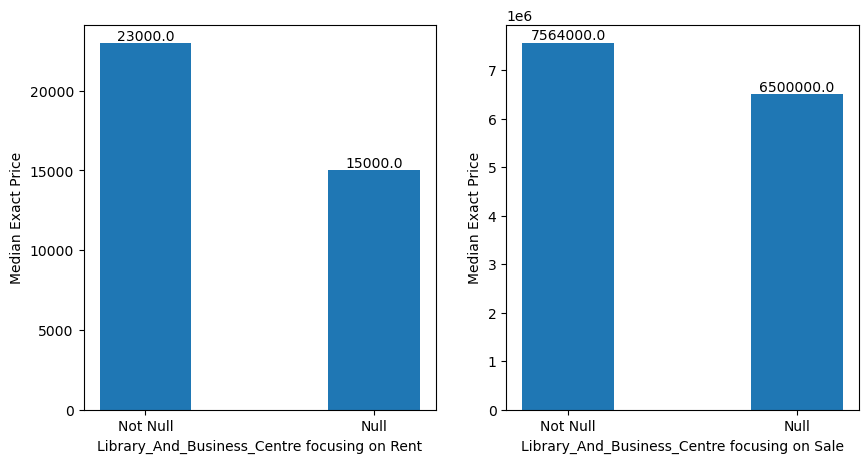

Library 79.07  % missing values


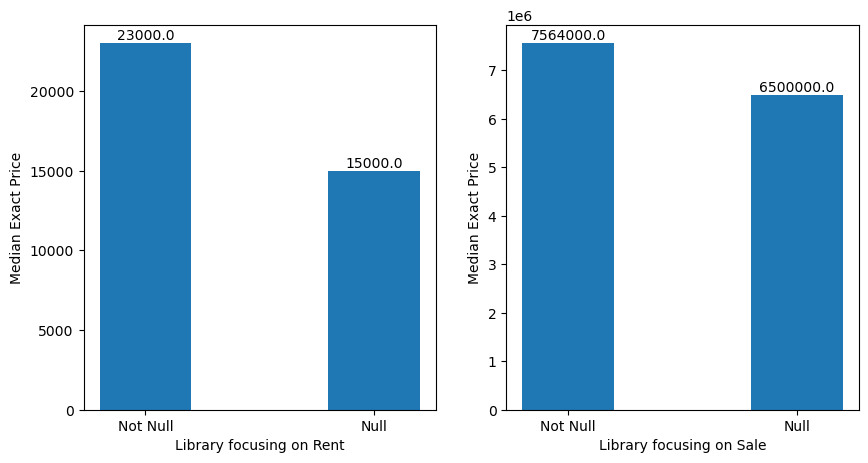

Laundry_Service 79.07  % missing values


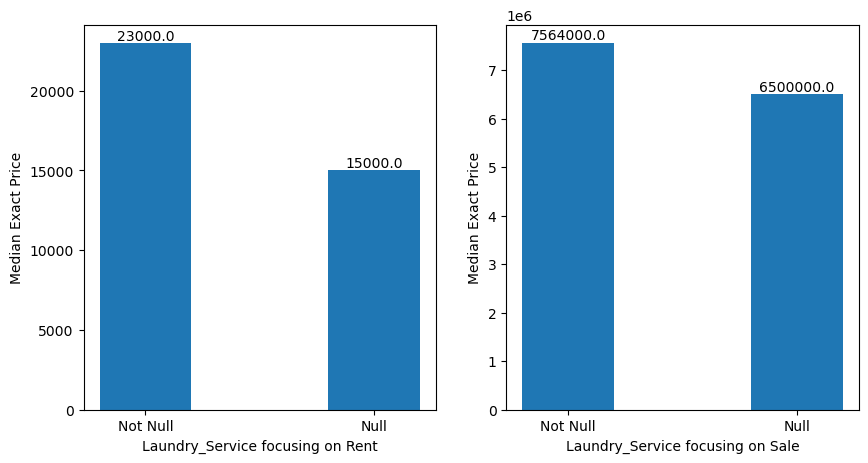

Lat 7.7700000000000005  % missing values


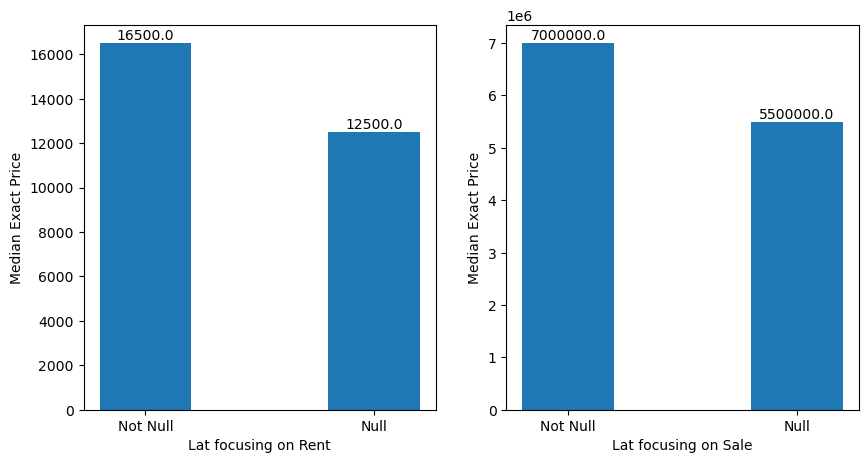

Kids_Play_Pool_With_Water_Slides 79.07  % missing values


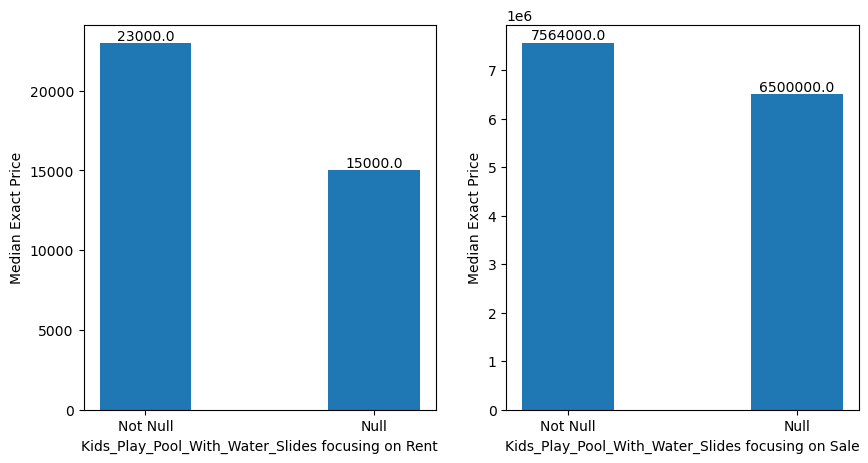

Kids_Play_Area 79.07  % missing values


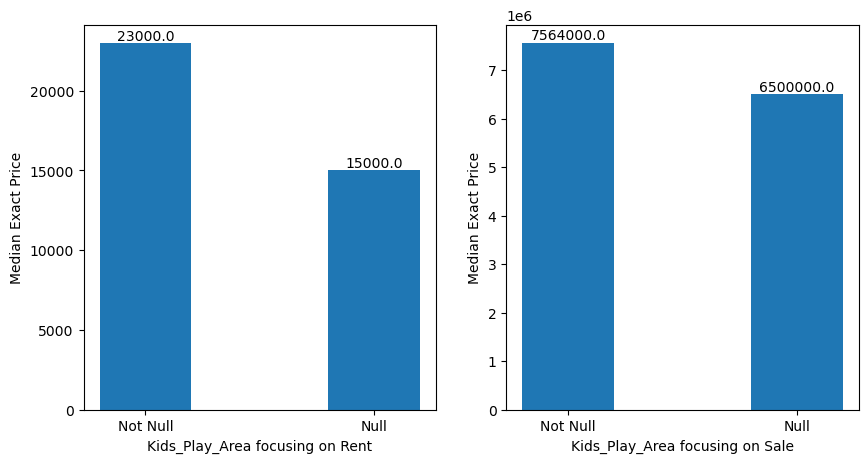

Kids_Club 79.07  % missing values


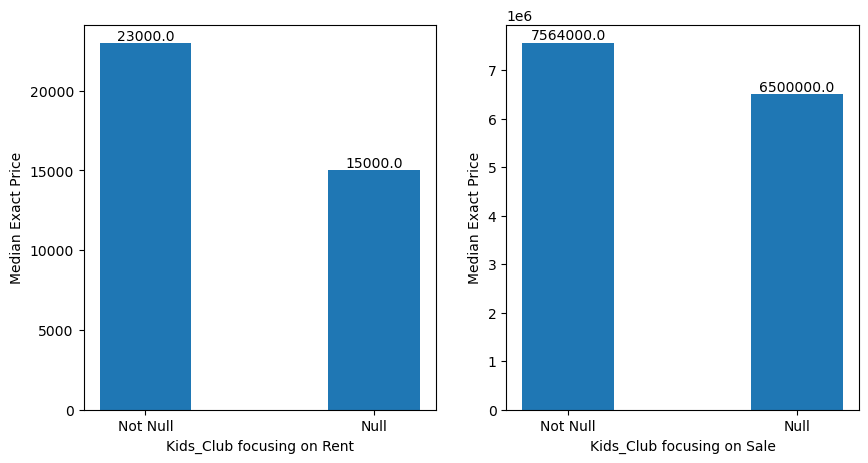

Jogging_and_Strolling_Track 79.07  % missing values


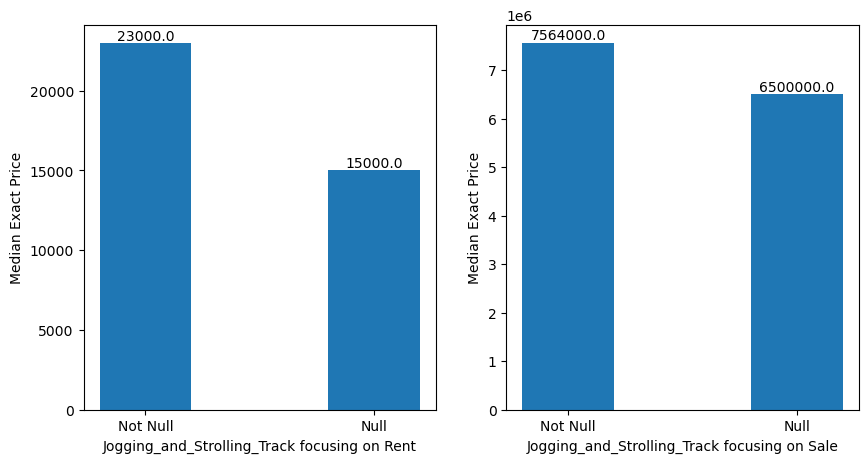

Internet_Or_Wi_Fi_Connectivity 79.07  % missing values


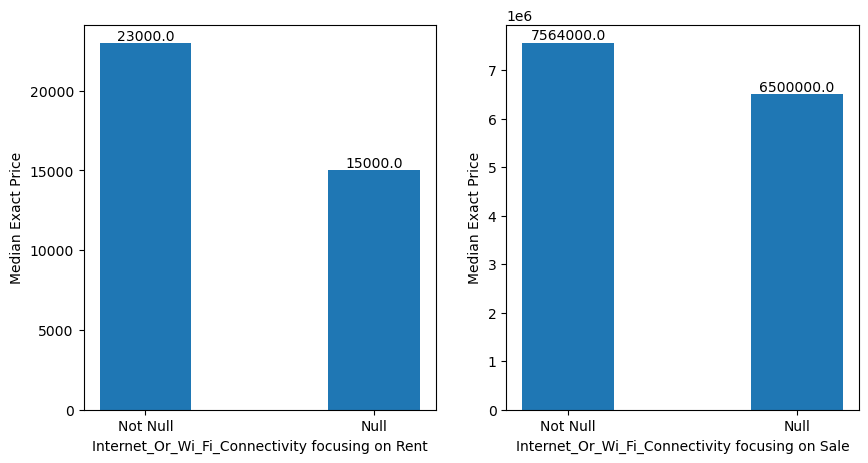

Intercom_Facility 79.07  % missing values


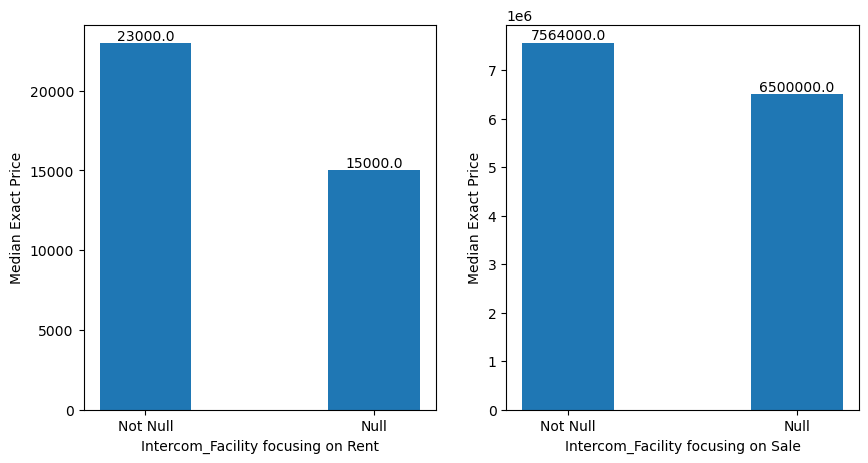

Indoor_Squash__And__Badminton_Courts 79.07  % missing values


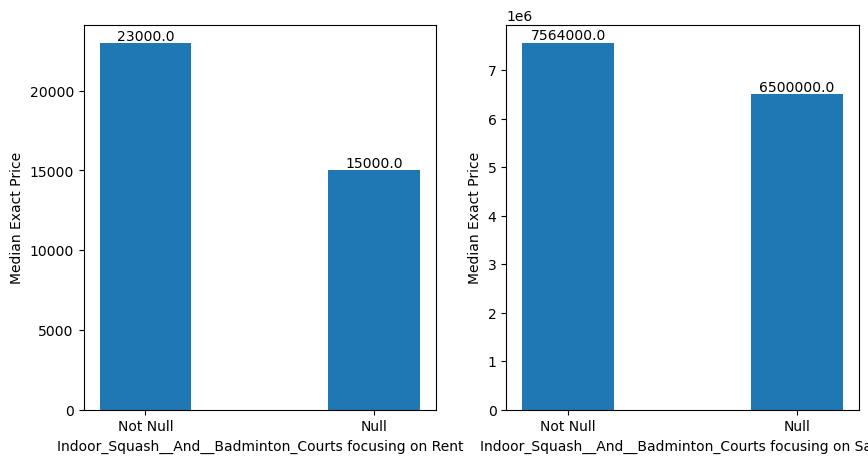

Indoor_Games_Room 79.07  % missing values


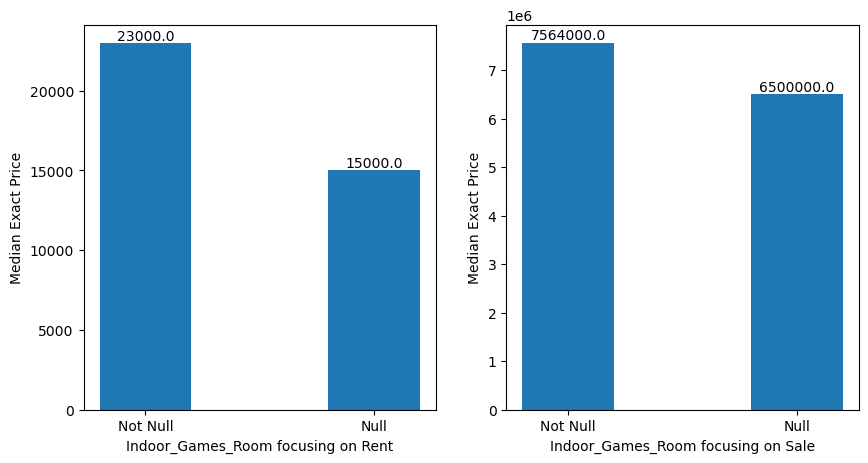

Health_club_with_Steam__Or__Jaccuzi 79.07  % missing values


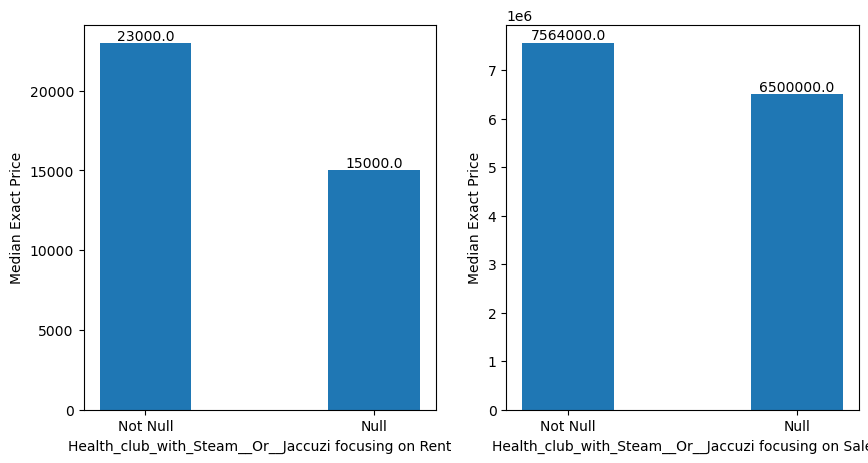

Gymnasium 79.07  % missing values


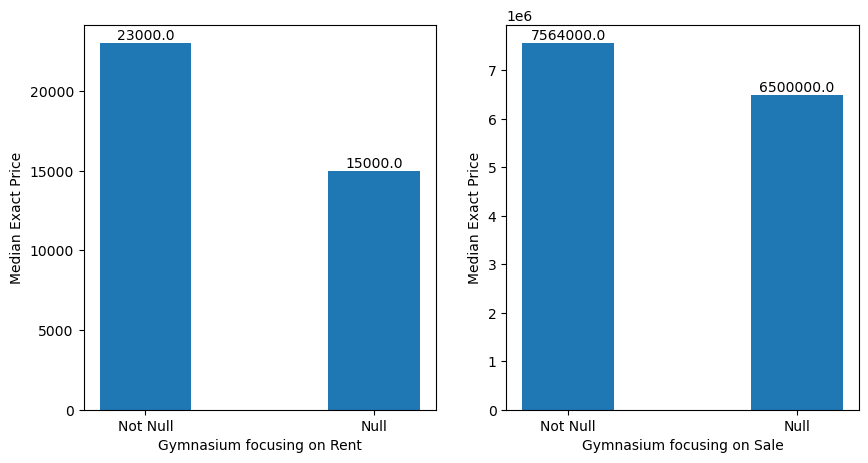

Guest_Accommodation 79.07  % missing values


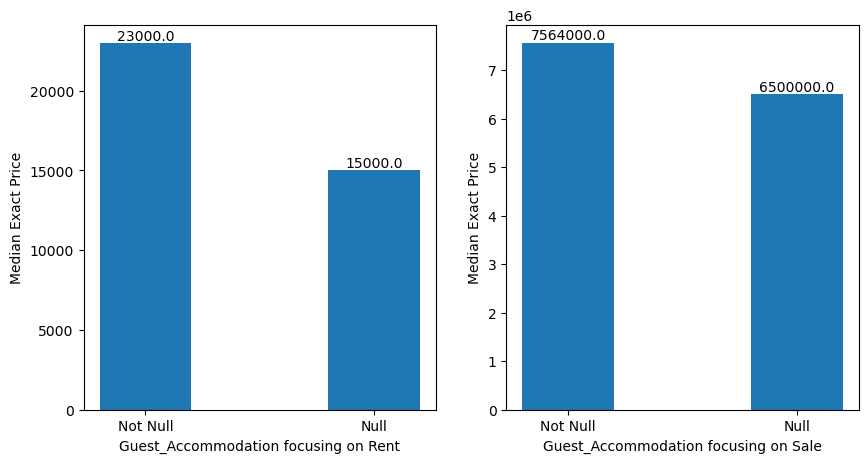

Grand_Entrance_lobby 79.07  % missing values


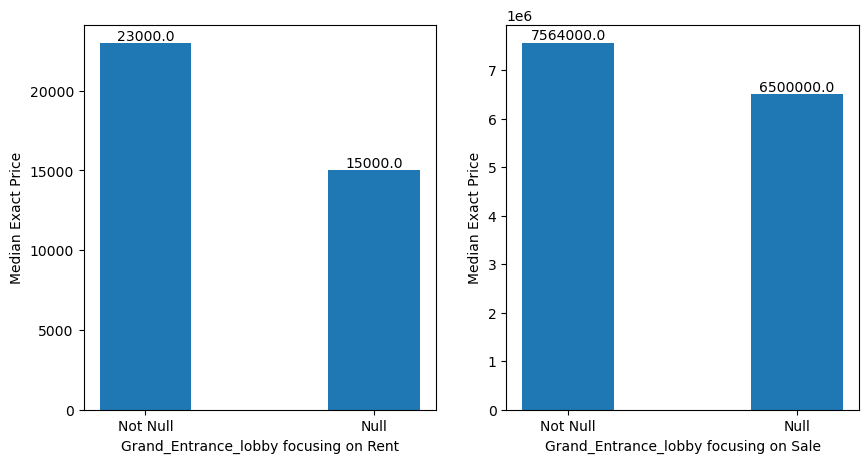

Golf_Course 79.07  % missing values


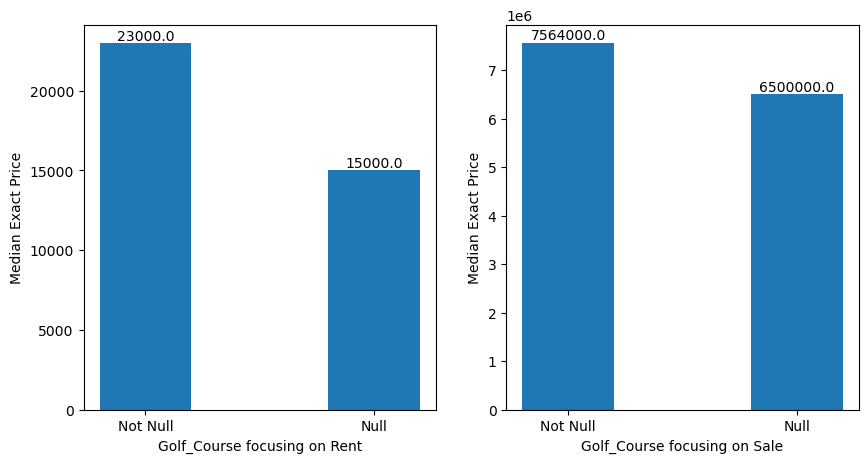

Flower_Gardens 79.07  % missing values


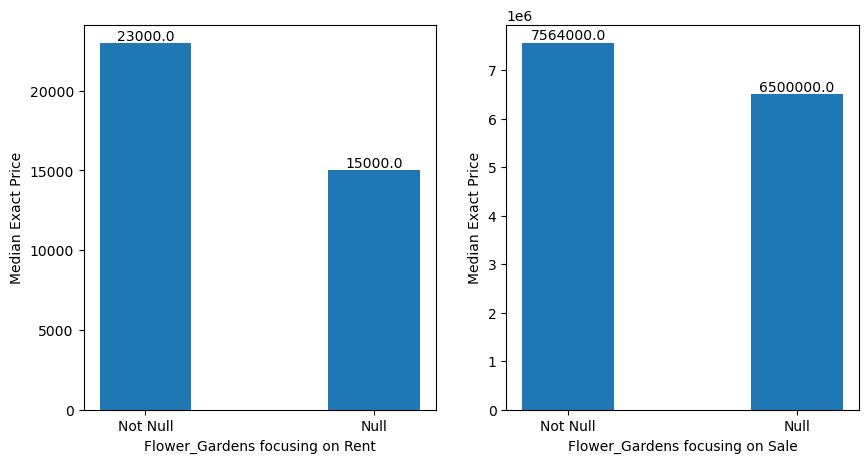

Fire_Fighting_Equipment 79.07  % missing values


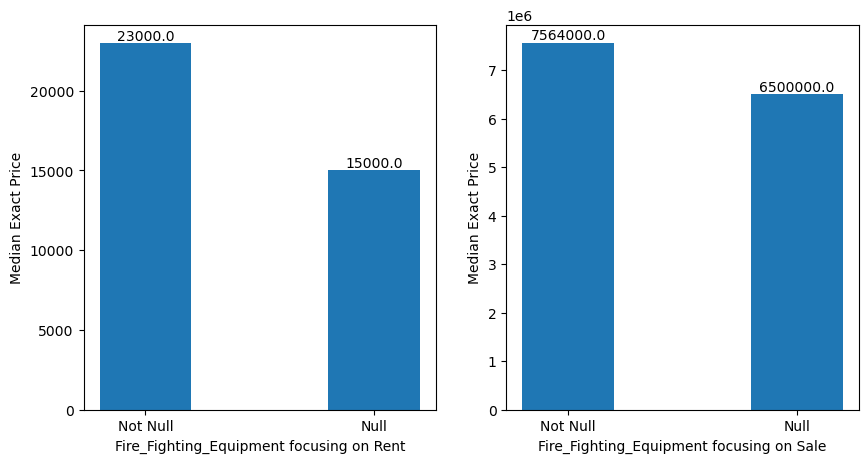

Event_Space__And__Amphitheatre 79.07  % missing values


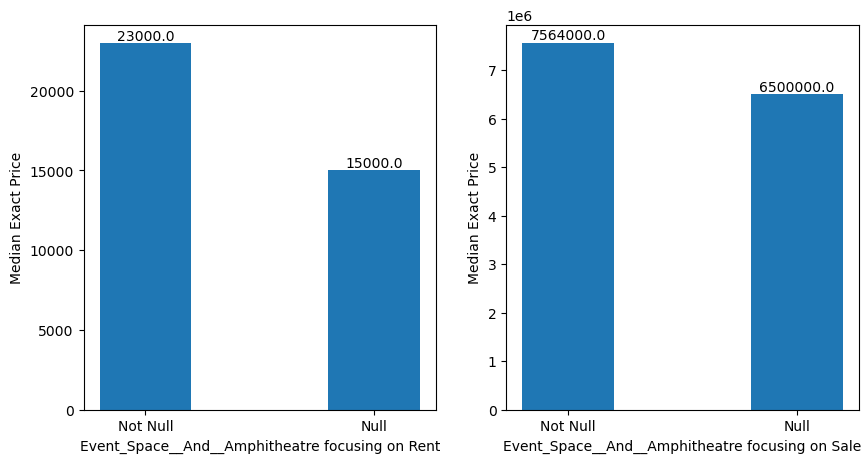

Earth_quake_resistant 79.07  % missing values


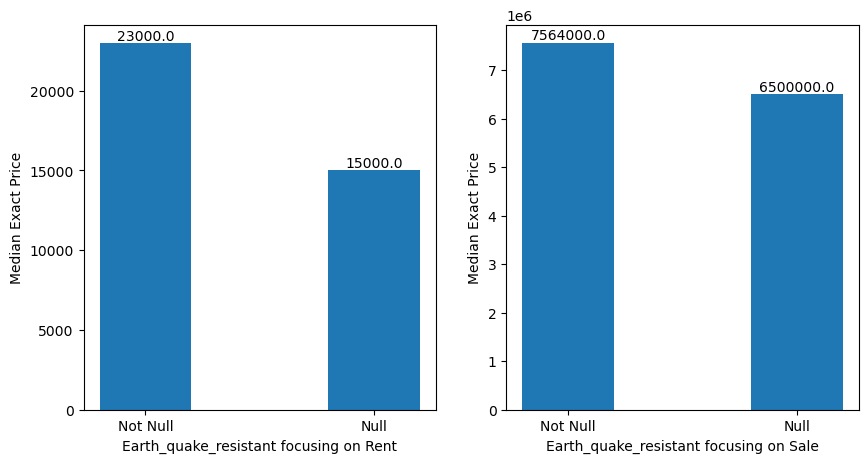

Early_Learning_Centre 79.07  % missing values


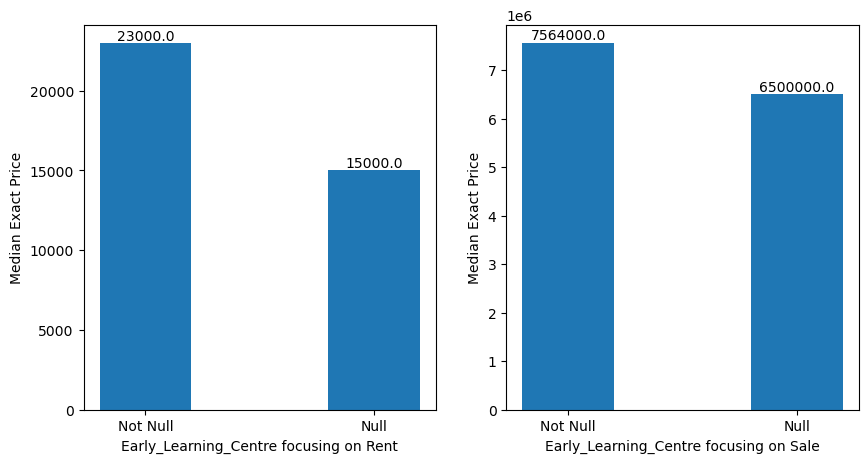

Dance_Studio 79.07  % missing values


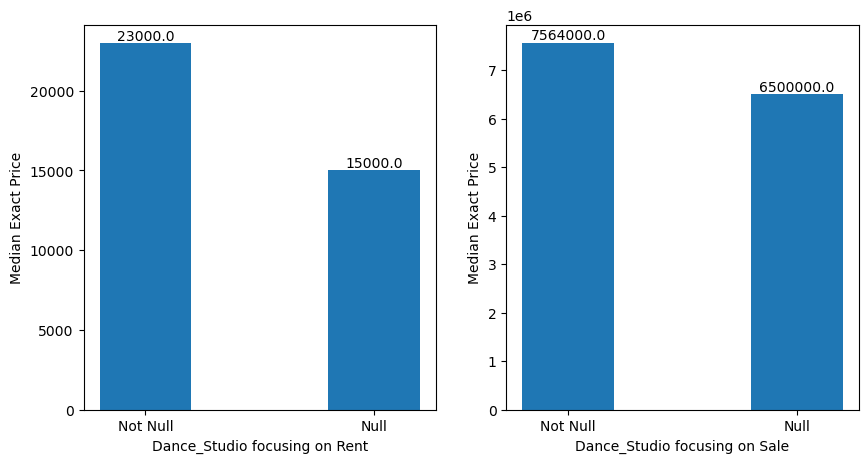

DTH_Television_Facility 79.07  % missing values


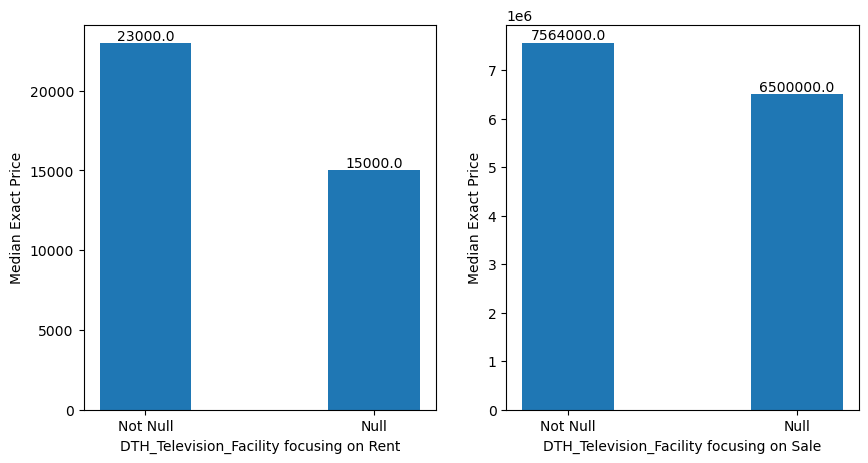

Cycling__And__Jogging_Track 79.07  % missing values


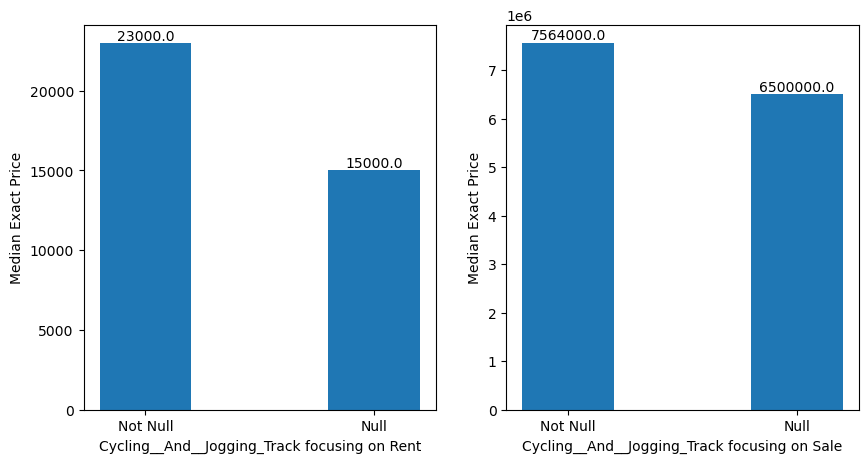

Cricket_net_practice 79.07  % missing values


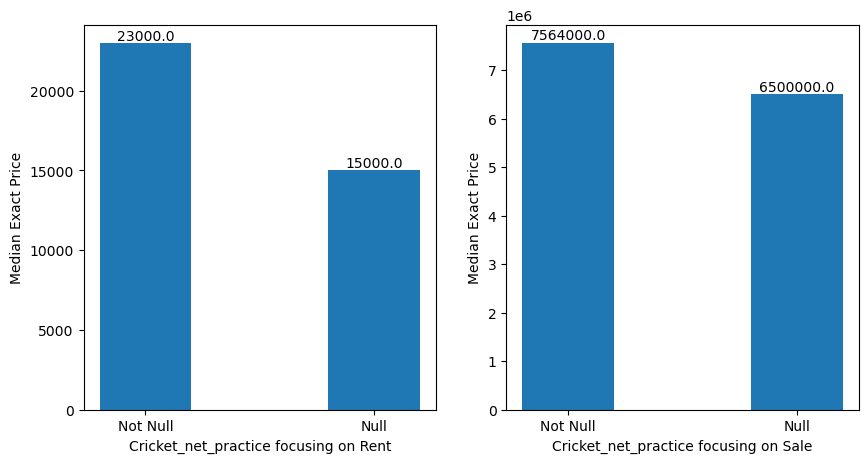

Conference_Room 79.07  % missing values


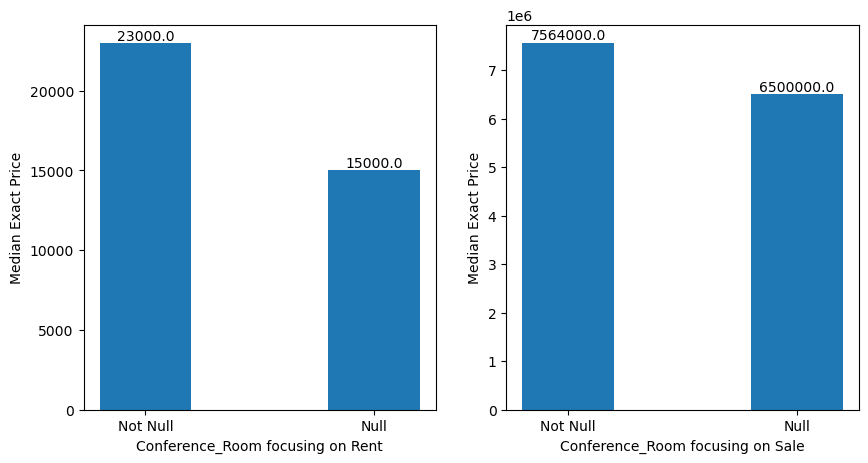

Concierge_Services 79.07  % missing values


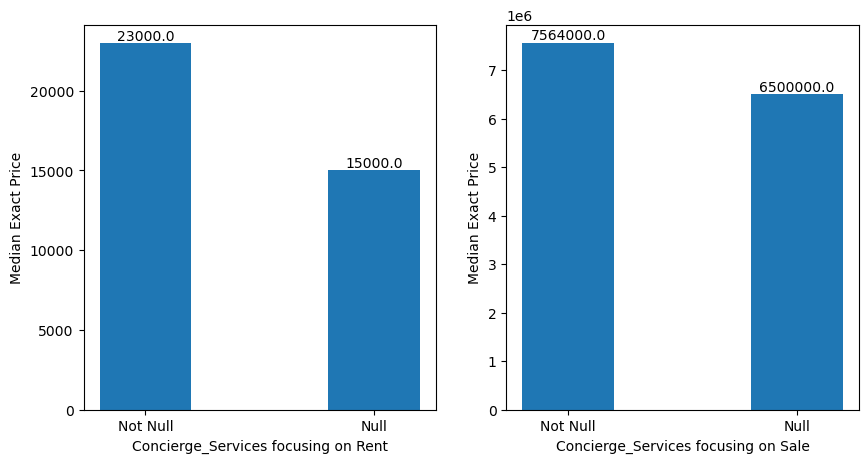

Coffee_Lounge__And__Restaurants 79.07  % missing values


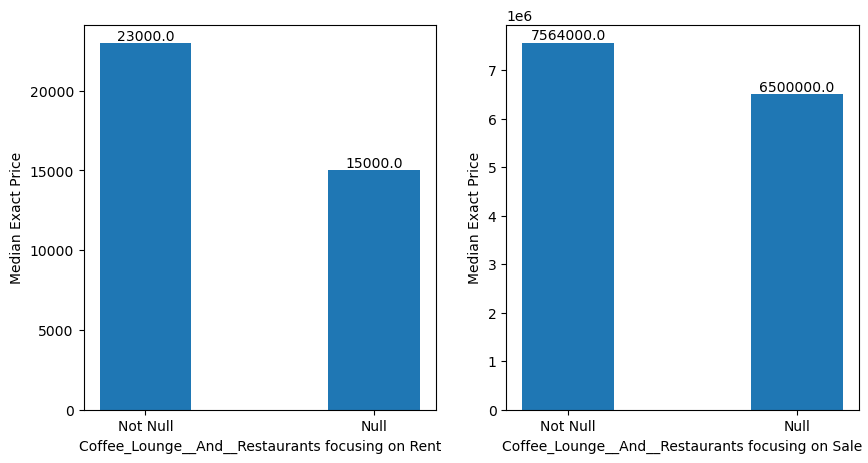

Club_House 79.07  % missing values


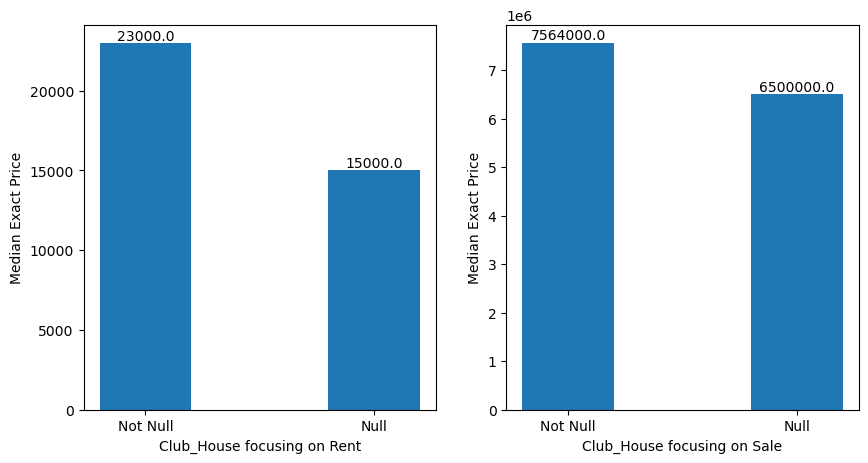

Canopy_Walk 79.07  % missing values


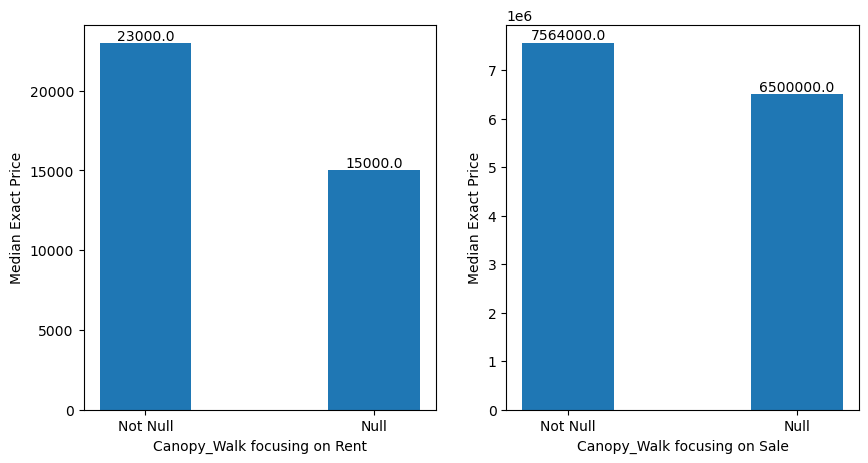

Cafeteria_Or_Food_Court 79.07  % missing values


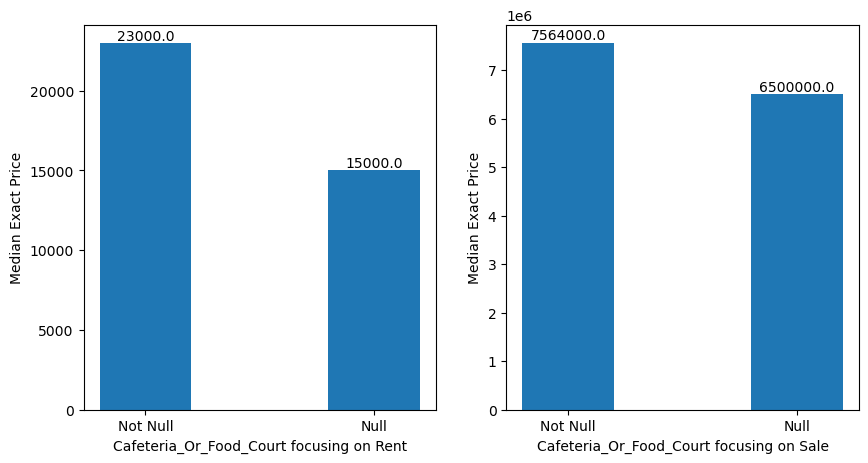

CCTV_Camera 79.07  % missing values


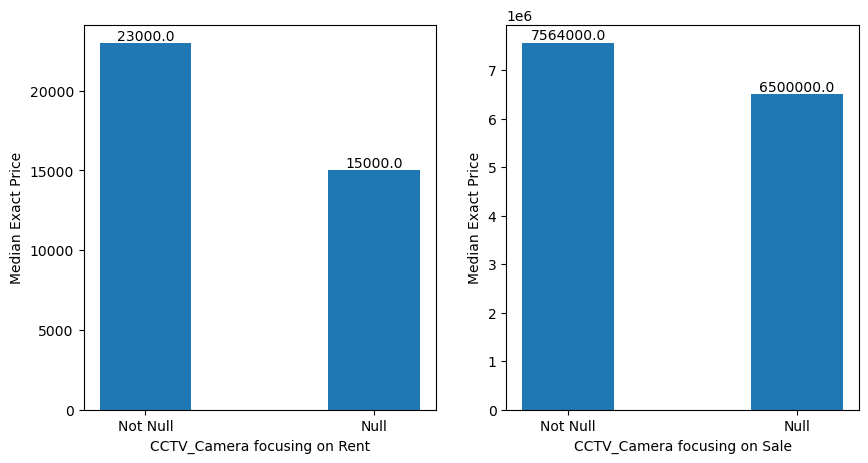

Barbeque_Pit 79.07  % missing values


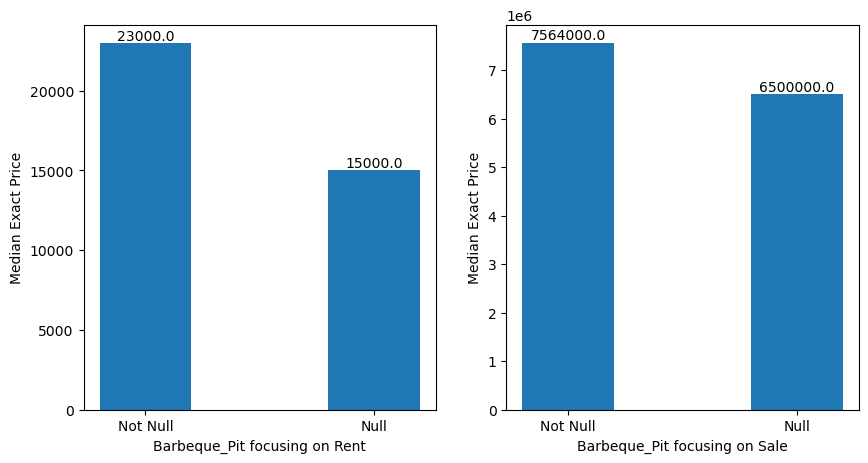

Bar_Or_Lounge 79.07  % missing values


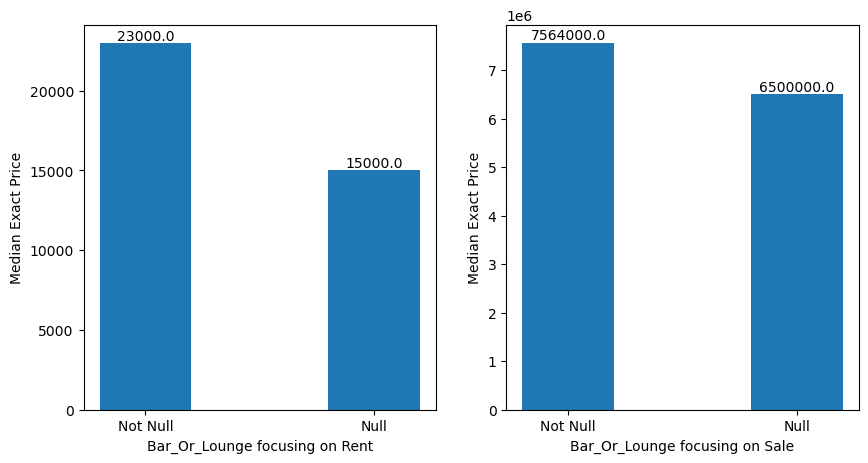

Banquet_Hall 79.07  % missing values


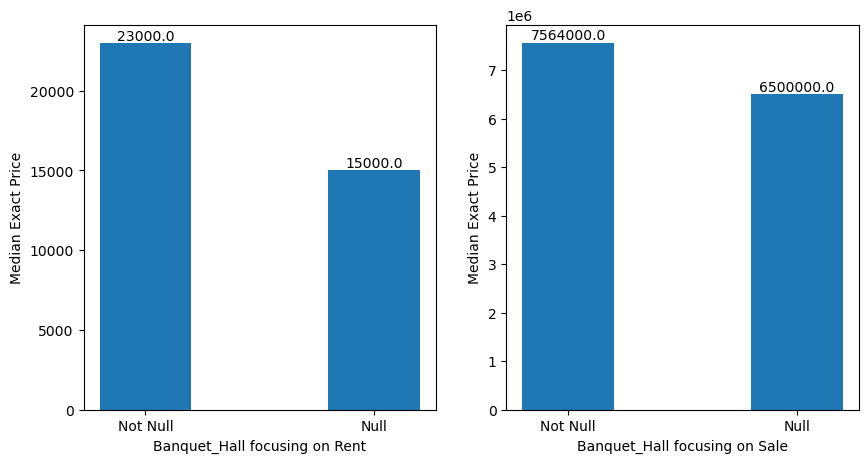

Bank__And__ATM 79.07  % missing values


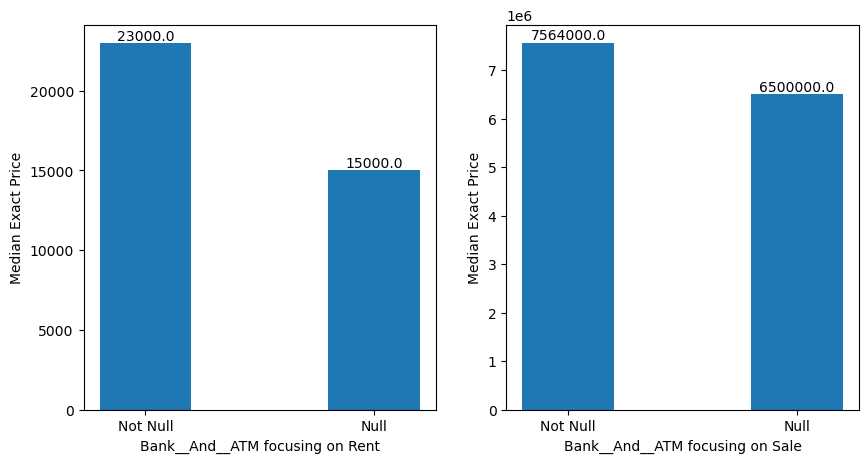

Arts__And__Craft_Studio 79.07  % missing values


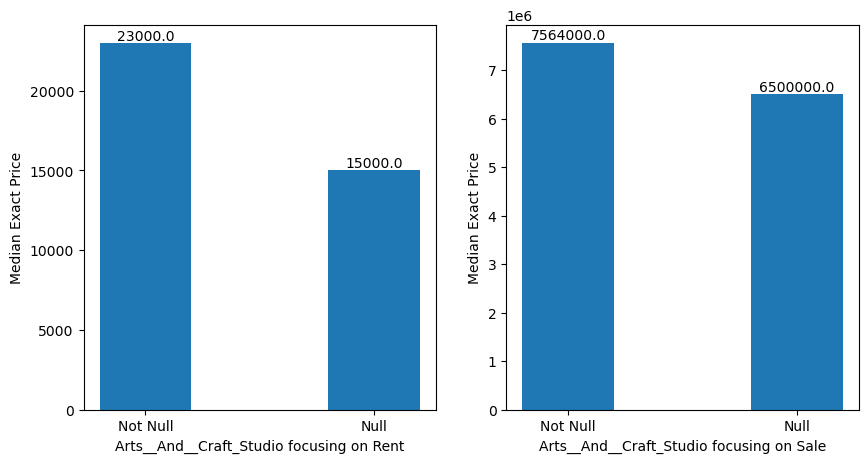

Air_Conditioned 79.07  % missing values


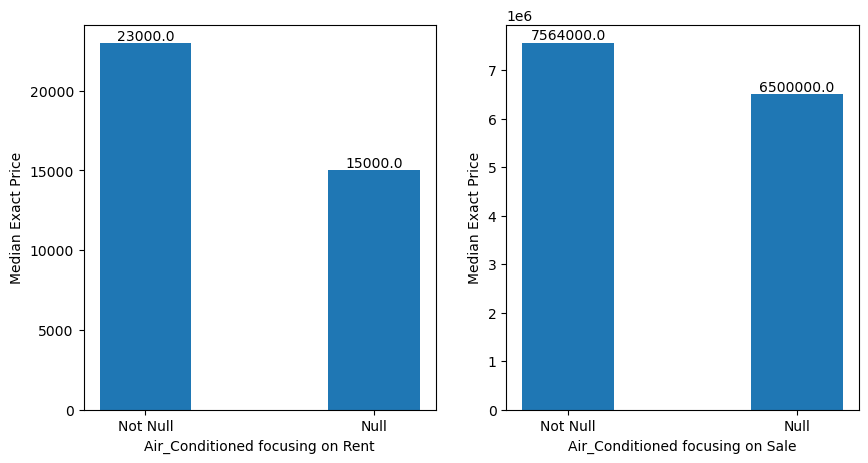

Activity_Deck4 79.07  % missing values


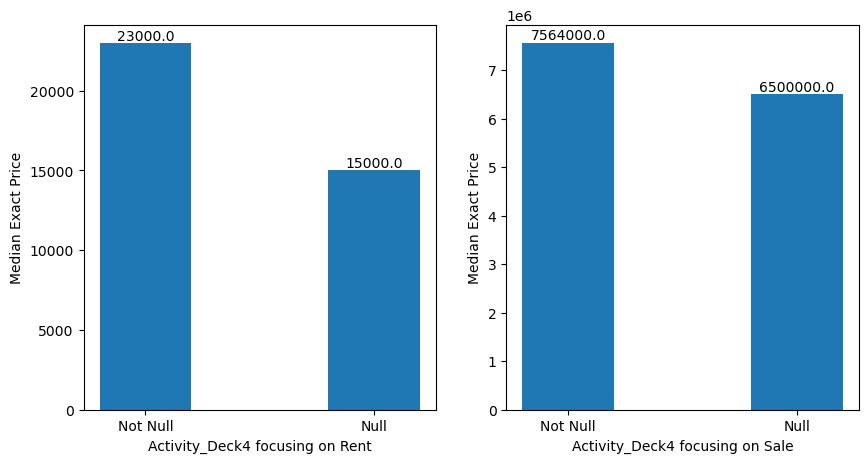

AEROBICS_ROOM 79.07  % missing values


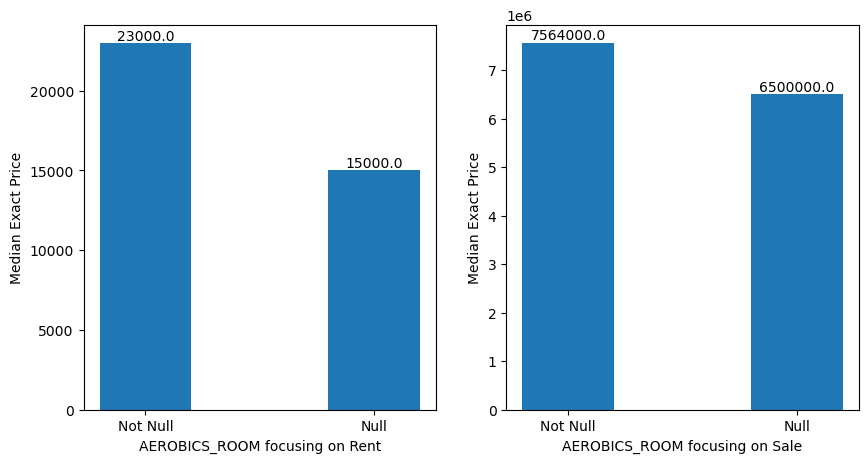

In [49]:
for feature in features_with_na:
    data = dataset.copy()

    data[feature] = np.where(data[feature].isnull(), 1, 0)
    print(feature, (np.round(Main_dataset[feature].isnull().mean(), 4)*100),  ' % missing values')

    bar_width = 0.4
    # grouped_data = data.groupby(feature)['exactPrice'].median()

    # Create a multibar plot
    category_data_rent = data[data['RentOrSale'] == "Rent"]

    category_data_sale = data[data['RentOrSale'] == "Sale"]

    dict = {0 :"Not Null", 1 :"Null"}

    def keys(x):
        key = dict[x]
        return key
    
    ### Rent subplot
    plt.figure(figsize = (10,5))
    plt.subplot(1,2,1)
    median_values = category_data_rent.groupby(feature)['exactPrice'].median()

    # since here 0 represents Not Null values and 1 represents Null values
    LIST = list(median_values.index)
    x = list(map(keys,LIST))

    if len(x) == 1:
        bar_width = 4
        if x == ["Null"]:
            impFea.add(feature)
    else:
         if median_values[1] > median_values[0]:
              impFea.add(feature)
    
    plt.bar(x, median_values, width=bar_width, label="Rent")

    for i,val in enumerate(LIST):
        plt.text(val,median_values[val],median_values[val],ha = "center", va = "bottom")

    str = f"{feature} focusing on Rent"
    plt.xlabel(str)
    plt.ylabel('Median Exact Price')


    ### Sale subplot
    plt.subplot(1,2,2)
    bar_width = 0.4
    median_values = category_data_sale.groupby(feature)['exactPrice'].median()
   
    # since here 0 represents Not Null values and 1 represents Null values
    LIST = list(median_values.index)
    x = list(map(keys,LIST))

    if len(x) == 1:
        bar_width = 4
        if x == ["Null"]:
            impFea.add(feature)


    else:
         if median_values[1] > median_values[0]:
              impFea.add(feature)

    plt.bar(x, median_values, width=bar_width, label="Sale")

    
    for i,val in enumerate(LIST):
        plt.text(val,median_values[val],median_values[val],ha = "center", va = "bottom")

    str = f"{feature} focusing on Sale"
    plt.xlabel(str)
    plt.ylabel('Median Exact Price')

    

    # Show the plot
    plt.show()
    

In [50]:
#  We got the important features
impFea

{'bathrooms',
 'bedrooms',
 'firstMonthCharges',
 'flrNum',
 'maintenanceCharges',
 'securityDeposit',
 'sqftPrice',
 'totalFlrNum'}

#### Using the postedOn feature to make new feature postedOn_DaysAgo, to represent how long ago the property was poster on the website

In [51]:
import datetime

# date_string = "Jun 20, '23"
def date_transform(date):

    date_object = datetime.datetime.strptime(date, "%b %d, '%y")
    formatted_date = datetime.datetime.strftime(date_object,"%Y-%m-%d")
    new_date = datetime.datetime.strptime(formatted_date, "%Y-%m-%d").date()


    current_date = datetime.date.today()
    ab = (current_date - new_date).days
    return ab


date_transform(dataset["postedOn"][10])

16

In [52]:
dataset["postedOn_DaysAgo"] = dataset["postedOn"].apply(date_transform)

In [53]:
dataset

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM,postedOn_DaysAgo
0,240000.0,171.0,NaN,Multistorey Apartment,"Jun 20, '23",NaN,NaN,NaN,Danapur,Semi-Furnished,4,NaN,NaN,6.0,Patna,NaN,NaN,3.0,2.0,NaN,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.056330,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,20
1,12000.0,12.0,12000.0,Multistorey Apartment,"Jun 19, '23",1,Monthly,1500.0,NaN,Semi-Furnished,4,25500.0,NaN,5.0,Patna,900.0,NaN,2.0,2.0,2.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21
2,17000.0,7.0,NaN,Residential House,"Jun 21, '23",NaN,NaN,NaN,Phase 1 Ashiana Nagar,Semi-Furnished,Ground,NaN,NaN,2.0,Patna,1300.0,NaN,3.0,3.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/3-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.079964,NaN,NaN,NaN,NaN,25.621426,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19
3,5000.0,NaN,NaN,Residential House,"Jun 23, '23",NaN,NaN,NaN,Kumhrar,Furnished,NaN,NaN,NaN,3.0,Patna,120.0,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/1-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185006,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17
4,12000.0,NaN,24000.0,Multistorey Apartment,"Jun 24, '23",1,Monthly,500.0,Kumhrar,Unfurnished,1,36500.0,East,5.0,Patna,1200.0,NaN,2.0,2.0,3.0,NaN,NaN,NaN,NaN,https://www.magicbricks.com/propertyDetails/2-...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Rent,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85.185005,NaN,NaN,NaN,NaN,25.593090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [54]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26692 entries, 0 to 27899
Data columns (total 91 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   exactPrice                            26692 non-null  float64
 1   sqftPrice                             24150 non-null  float64
 2   securityDeposit                       8448 non-null   float64
 3   propertyType                          26692 non-null  object 
 4   postedOn                              26692 non-null  object 
 5   noOfLifts                             4923 non-null   object 
 6   maintenanceChargesFrequency           6589 non-null   object 
 7   maintenanceCharges                    4514 non-null   float64
 8   locality                              24520 non-null  object 
 9   furnishing                            26358 non-null  object 
 10  flrNum                                21117 non-null  object 
 11  firstMonthCharg

### Filling the null values with  missing for important features

In [55]:
dataset[list(impFea)] = dataset[list(impFea)].fillna(value = "Missing")

In [56]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26692 entries, 0 to 27899
Data columns (total 91 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   exactPrice                            26692 non-null  float64
 1   sqftPrice                             26692 non-null  object 
 2   securityDeposit                       26692 non-null  object 
 3   propertyType                          26692 non-null  object 
 4   postedOn                              26692 non-null  object 
 5   noOfLifts                             4923 non-null   object 
 6   maintenanceChargesFrequency           6589 non-null   object 
 7   maintenanceCharges                    26692 non-null  object 
 8   locality                              24520 non-null  object 
 9   furnishing                            26358 non-null  object 
 10  flrNum                                26692 non-null  object 
 11  firstMonthCharg

In [57]:
features_with_na=[features for features in dataset.columns if dataset[features].isnull().sum()>1]

for feature in features_with_na:
    
    print(feature, np.round((dataset[feature].isnull().mean())*100, 4),  ' % missing values\n')


noOfLifts 81.5563  % missing values

maintenanceChargesFrequency 75.3147  % missing values

locality 8.1373  % missing values

furnishing 1.2513  % missing values

facing 50.3484  % missing values

carpetArea 44.6763  % missing values

brokerage 78.3268  % missing values

balconies 36.318  % missing values

Water_Storage 78.2144  % missing values

Waste_Disposal 78.2144  % missing values

Visitor_Parking 78.2144  % missing values

Vaastu_Compliant 78.2144  % missing values

Swimming_Pool 78.2144  % missing values

Skydeck 78.2144  % missing values

Service_Or_Goods_Lift 78.2144  % missing values

Security 78.2144  % missing values

Retail_Boulevard___Retail_Shops__ 78.2144  % missing values

Reserved_Parking 78.2144  % missing values

Rentable_Community_Space 78.2144  % missing values

Recreational_Pool 78.2144  % missing values

Rain_Water_Harvesting 78.2144  % missing values

RO_Water_System 78.2144  % missing values

Private_Terrace_Or_Garden 78.2144  % missing values

Private_Garde

### Filling the null values with  missing for the features with low null values, less than 10%

In [58]:
fea_low_null =[]

for feature in features_with_na:
    
    if np.round((dataset[feature].isnull().mean())*100, 4)<10:
        print(feature)
        fea_low_null.append(feature)


locality
furnishing
Long
Lat


In [59]:
dataset[fea_low_null] = dataset[fea_low_null].fillna(value= "Missing")

In [60]:
Not_null_fea = []

In [61]:
for feature in dataset.columns:
    if np.around(dataset[feature].isnull().sum()) == 0:
        Not_null_fea.append(feature)

In [62]:
Not_null_fea.remove("URLs")
Not_null_fea.remove("postedOn")

In [63]:
dataset_final = dataset[Not_null_fea] 

In [64]:
dataset_final.isna().sum()

exactPrice            0
sqftPrice             0
securityDeposit       0
propertyType          0
maintenanceCharges    0
locality              0
furnishing            0
flrNum                0
firstMonthCharges     0
totalFlrNum           0
city                  0
bedrooms              0
bathrooms             0
RentOrSale            0
Long                  0
Lat                   0
postedOn_DaysAgo      0
dtype: int64

In [65]:
dataset_final

,exactPrice,sqftPrice,securityDeposit,propertyType,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,totalFlrNum,city,bedrooms,bathrooms,RentOrSale,Long,Lat,postedOn_DaysAgo
0,240000.0,171.0,Missing,Multistorey Apartment,Missing,Danapur,Semi-Furnished,4,Missing,6.0,Patna,3.0,2.0,Rent,85.05633,25.605898,20
1,12000.0,12.0,12000.0,Multistorey Apartment,1500.0,Missing,Semi-Furnished,4,25500.0,5.0,Patna,2.0,2.0,Rent,Missing,Missing,21
2,17000.0,7.0,Missing,Residential House,Missing,Phase 1 Ashiana Nagar,Semi-Furnished,Ground,Missing,2.0,Patna,3.0,3.0,Rent,85.079964,25.621426,19
3,5000.0,Missing,Missing,Residential House,Missing,Kumhrar,Furnished,Missing,Missing,3.0,Patna,1.0,1.0,Rent,85.185006,25.59309,17
4,12000.0,Missing,24000.0,Multistorey Apartment,500.0,Kumhrar,Unfurnished,1,36500.0,5.0,Patna,2.0,2.0,Rent,85.185005,25.59309,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27895,20227500.0,7500.0,Missing,Multistorey Apartment,Missing,Dalanwala,Semi-Furnished,1,Missing,Missing,Dehradun,3.0,4.0,Sale,78.056634,30.314961,9
27896,6933500.0,4900.0,Missing,Multistorey Apartment,Missing,Canal Road,Semi-Furnished,5,Missing,6.0,Dehradun,2.0,2.0,Sale,78.081697,30.37089,10
27897,9000000.0,8182.0,Missing,Villa,Missing,Aman Vihar,Unfurnished,Missing,Missing,2.0,Dehradun,3.0,3.0,Sale,78.07724,30.354673,8
27898,7645000.0,5500.0,Missing,Multistorey Apartment,Missing,Sahastradhara Road,Unfurnished,4,Missing,8.0,Dehradun,3.0,2.0,Sale,78.082277,30.354086,9


### Changing categorical_features to numeric features for model building

In [66]:
categorical_features=[feature for feature in dataset_final.columns if dataset_final[feature].dtype=='O']


In [67]:
for feature in categorical_features:
    data =dataset_final
    labels_ordered=data.groupby([feature])['exactPrice'].mean().sort_values().index
    labels_ordered={k:i for i,k in enumerate(labels_ordered,0)}
    data[feature]=data[feature].map(labels_ordered)


/tmp/ipykernel_31/1309825740.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[feature]=data[feature].map(labels_ordered)
/tmp/ipykernel_31/1309825740.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[feature]=data[feature].map(labels_ordered)
/tmp/ipykernel_31/1309825740.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas

In [ ]:
data

,exactPrice,sqftPrice,securityDeposit,propertyType,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,totalFlrNum,city,bedrooms,bathrooms,RentOrSale,Long,Lat,postedOn_DaysAgo
0,240000.0,145,312,3,256,3119,1,3,1945,4,12,2,1,0,5043,5067,20
1,12000.0,20,54,3,111,2633,1,3,296,1,12,1,1,0,4829,4853,21
2,17000.0,8,312,2,256,2775,1,6,1945,12,12,2,2,0,4827,4851,19
3,5000.0,919,312,2,256,2338,0,12,1945,6,12,0,0,0,4342,4362,17
4,12000.0,919,82,3,121,2338,3,0,410,1,12,1,1,0,1126,1129,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27895,20227500.0,3408,312,3,256,3351,1,0,1945,14,13,2,4,1,5907,5938,9
27896,6933500.0,2077,312,3,256,3232,1,5,1945,4,13,1,1,1,5925,5956,10
27897,9000000.0,2286,312,5,256,3362,3,12,1945,12,13,2,2,1,5259,5283,8
27898,7645000.0,2345,312,3,256,2960,3,3,1945,3,13,2,1,1,5258,5281,9


In [69]:
scaling_feature=[feature for feature in dataset_final.columns if feature not in ['exactPrice'] ]
len(scaling_feature)

16

### Since I am going to make a web app for people to predict cost of their preferencial houses, I am discarding the features['sqftPrice','Long','Lat', 'securityDeposit','firstMonthCharges', 'maintenanceCharges'] 

In [70]:


scaling_feature = [feature for feature in scaling_feature if feature not in ['sqftPrice','Long','Lat', 'securityDeposit','firstMonthCharges',"maintenanceCharges" ]]

In [71]:
scaling_feature

['propertyType',
 'locality',
 'furnishing',
 'flrNum',
 'totalFlrNum',
 'city',
 'bedrooms',
 'bathrooms',
 'RentOrSale',
 'postedOn_DaysAgo']

### Scaling features

In [72]:

from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()
scaler.fit(dataset_final[scaling_feature])

MinMaxScaler()

In [73]:
scaler.transform(dataset_final[scaling_feature])


array([[6.00000000e-01, 8.22087507e-01, 3.33333333e-01, ...,
        1.11111111e-01, 0.00000000e+00, 6.34584876e-03],
       [6.00000000e-01, 6.93990511e-01, 3.33333333e-01, ...,
        1.11111111e-01, 0.00000000e+00, 6.87466949e-03],
       [4.00000000e-01, 7.31418028e-01, 3.33333333e-01, ...,
        2.22222222e-01, 0.00000000e+00, 5.81702803e-03],
       ...,
       [1.00000000e+00, 8.86136004e-01, 1.00000000e+00, ...,
        2.22222222e-01, 1.00000000e+00, 0.00000000e+00],
       [6.00000000e-01, 7.80179230e-01, 1.00000000e+00, ...,
        1.11111111e-01, 1.00000000e+00, 5.28820730e-04],
       [6.00000000e-01, 8.22614655e-01, 3.33333333e-01, ...,
        2.22222222e-01, 1.00000000e+00, 1.05764146e-03]])

In [74]:
data = pd.concat([data[["exactPrice"]].reset_index(drop=True),
                    pd.DataFrame(scaler.transform(data[scaling_feature]), columns=scaling_feature)],
                    axis=1)

In [ ]:
data

,exactPrice,propertyType,locality,furnishing,flrNum,totalFlrNum,city,bedrooms,bathrooms,RentOrSale,postedOn_DaysAgo
0,240000.0,0.6,0.822088,0.333333,0.049180,0.0500,0.705882,0.222222,0.111111,0.0,0.006346
1,12000.0,0.6,0.693991,0.333333,0.049180,0.0125,0.705882,0.111111,0.111111,0.0,0.006875
2,17000.0,0.4,0.731418,0.333333,0.098361,0.1500,0.705882,0.222222,0.222222,0.0,0.005817
3,5000.0,0.4,0.616236,0.000000,0.196721,0.0750,0.705882,0.000000,0.000000,0.0,0.004759
4,12000.0,0.6,0.616236,1.000000,0.000000,0.0125,0.705882,0.111111,0.111111,0.0,0.004231
...,...,...,...,...,...,...,...,...,...,...,...
26687,20227500.0,0.6,0.883237,0.333333,0.000000,0.1750,0.764706,0.222222,0.444444,1.0,0.000529
26688,6933500.0,0.6,0.851871,0.333333,0.081967,0.0500,0.764706,0.111111,0.111111,1.0,0.001058
26689,9000000.0,1.0,0.886136,1.000000,0.196721,0.1500,0.764706,0.222222,0.222222,1.0,0.000000
26690,7645000.0,0.6,0.780179,1.000000,0.049180,0.0375,0.764706,0.222222,0.111111,1.0,0.000529


In [76]:
from sklearn.model_selection import train_test_split

### Creating Train Test split

In [77]:
x= data[scaling_feature]
y = np.log(data["exactPrice"])

In [78]:
max(y)

21.901920833288056

In [79]:
min(y)

6.907755278982137

In [80]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)

In [81]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

print(type(x_train))
print(type(y_train))
print(type(x_test))
print(type(y_test))

(17883, 10)
(17883,)
(8809, 10)
(8809,)
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>


In [82]:
x_train.head()


,propertyType,locality,furnishing,flrNum,totalFlrNum,city,bedrooms,bathrooms,RentOrSale,postedOn_DaysAgo
14950,0.2,0.416711,0.000000,0.016393,0.0750,0.352941,0.111111,0.111111,0.0,0.003173
19904,0.4,0.731945,1.000000,0.196721,0.0625,0.529412,0.000000,0.111111,1.0,0.013749
17467,0.6,0.357406,0.000000,0.016393,0.0250,0.352941,0.000000,0.000000,0.0,0.000000
9620,0.2,0.693991,0.333333,0.000000,0.0625,0.588235,0.222222,0.111111,0.0,0.007403
1691,0.2,0.593832,1.000000,0.000000,0.1500,0.705882,0.000000,0.000000,0.0,0.038075


In [83]:
y_train.head()


14950    10.126631
19904    15.171346
17467     9.711116
9620      9.903488
1691      8.411833
Name: exactPrice, dtype: float64

In [84]:
x_train.columns

Index(['propertyType', 'locality', 'furnishing', 'flrNum', 'totalFlrNum',
       'city', 'bedrooms', 'bathrooms', 'RentOrSale', 'postedOn_DaysAgo'],
      dtype='object')

In [85]:
y_test

8158      9.615805
17935     8.853665
23430    15.820902
26129    16.341239
5453      8.853665
           ...    
12710    16.034714
18912    10.165852
21314    16.929026
967       9.305651
5547      9.798127
Name: exactPrice, Length: 8809, dtype: float64

In [86]:
len(y_test)

8809

### Choosing best Regressor algorithm for my dataset

In [87]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import VotingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor
from xgboost import XGBRegressor
from xgboost import XGBRegressor

from sklearn.metrics import mean_absolute_error,r2_score,classification_report


def train_model(m,name):
    model = m
    model.fit(x_train, y_train)
    predictions = model.predict(x_test)
    mae = mean_absolute_error(y_test, predictions)
    r2 = r2_score(y_test, predictions)
    print("{0} mae {2} r2 {1}".format(name,r2,mae))
    

reg2 = RandomForestRegressor(random_state=3,n_estimators =100,max_depth=4)
reg1 = XGBRegressor(n_estimators=1000)
ereg = VotingRegressor(estimators=[('gb', reg1), ('rf', reg2)])
ereg = ereg.fit(x_train, y_train)



train_model(DecisionTreeRegressor(),"Decision Tree Regressor")
train_model(RandomForestRegressor(random_state=3),"Random Forest Regressor")   
train_model(XGBRegressor(n_estimators=600),"XGBoost Regressor")   
train_model(GradientBoostingRegressor(random_state=1),"Gradient Regressor")   
train_model(ereg,"Voting Regressor")
train_model(ExtraTreesRegressor(),"Extra Trees Regressor")   
train_model(LinearRegression(),"Linear Regressor")


Decision Tree Regressor mae 0.40034117074155073 r2 0.964976151214026
Random Forest Regressor mae 0.29240821474606116 r2 0.9814657306723327
XGBoost Regressor mae 0.28816210652598073 r2 0.9822846103248641
Gradient Regressor mae 0.3121207990732899 r2 0.9807807096179676
Voting Regressor mae 0.3146982972135338 r2 0.9802611670540925
Extra Trees Regressor mae 0.29649221785730495 r2 0.9813411131867857
Linear Regressor mae 0.46638635043681065 r2 0.9615152217269071


#### Looks like the XGBoost Regressor has the best scores, lowest mean_absolute_error (0.288...) and highest r2 score (0.982...).
##### So, I am chossing XGBoost Regressor as the main algorithm
##### Keeping in mind that I need to convert that exactPrice feature using np.exp to give valid output,  its essential to have low mean_absolute_error

In [88]:
### training my final model

xgb = XGBRegressor(n_estimators=1000).fit(x_train, y_train)


predictions = xgb.predict(x_test)
r2 = r2_score(y_test, predictions)

print(r2*100,"%")

98.16305732965816 %


Text(0.5, 1.0, 'Feature Importance')

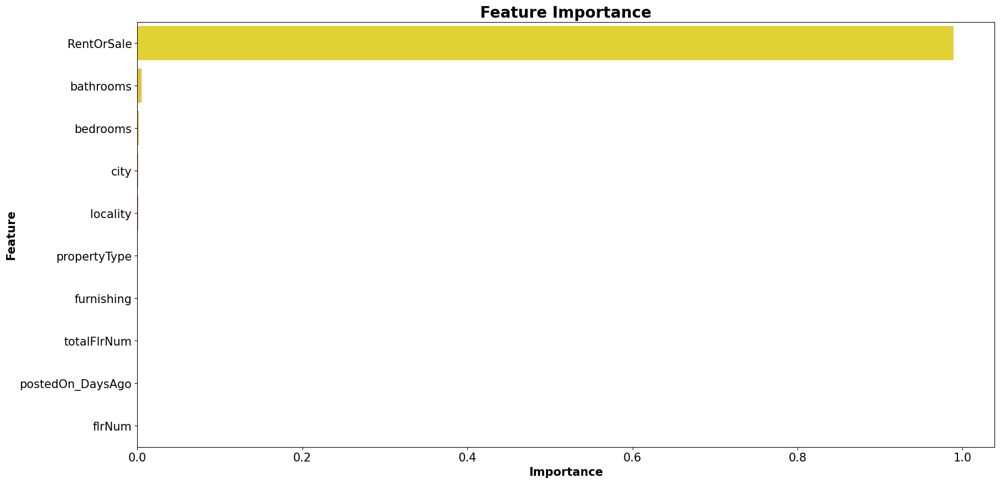

In [89]:
from sklearn.metrics import mean_absolute_error,r2_score,classification_report


fi = pd.DataFrame(xgb.feature_importances_,
             columns=['importance'])
fi['feature'] = scaling_feature
fi = fi.sort_values('importance', ascending=False)

plt.figure(figsize=(20, 10))
ax = sns.barplot(data=fi, x='importance', y='feature',
                 palette="spring_r")
ax.tick_params(axis='both', which='both', labelsize=15)
ax.set_xlabel('Importance',fontsize=15, weight="bold")
ax.set_ylabel('Feature',fontsize=15,weight="bold")
plt.title("Feature Importance", size=20, weight="bold")

#### Now that our model is finally ready, we can also predict the pices of the houses which had null vales in the exactPrice column and splitted it

# Recommendation for other Housing Options

### Here I made a simple recommendation system function to recommend other housing options according to the users preferences

In [90]:
combined_fea = ""

combined_fea = dataset["propertyType"] + "   " + dataset["locality"] + "   " + dataset["furnishing"] + "   " + dataset["flrNum"].astype("str") + "   " + dataset["totalFlrNum"].astype("str") + "   " + dataset["city"] + "   " + dataset["bedrooms"].astype("str") + "   " + dataset["bathrooms"].astype("str") + "   " + dataset["RentOrSale"] + "   " + dataset["Long"].astype("str") + "   " + dataset["Lat"].astype("str") + "   " + dataset["postedOn_DaysAgo"].astype("str")


combined_fea

0        Multistorey Apartment   Danapur   Semi-Furnish...
1        Multistorey Apartment   Missing   Semi-Furnish...
2        Residential House   Phase 1 Ashiana Nagar   Se...
3        Residential House   Kumhrar   Furnished   Miss...
4        Multistorey Apartment   Kumhrar   Unfurnished ...
                               ...                        
27895    Multistorey Apartment   Dalanwala   Semi-Furni...
27896    Multistorey Apartment   Canal Road   Semi-Furn...
27897    Villa   Aman Vihar   Unfurnished   Missing   2...
27898    Multistorey Apartment   Sahastradhara Road   U...
27899    Multistorey Apartment   General Mahadev Singh ...
Length: 26692, dtype: object

In [91]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity, sigmoid_kernel

In [92]:
vectorizer = TfidfVectorizer()

In [93]:
feature_vectors = vectorizer.fit_transform(combined_fea)

In [94]:
print(feature_vectors.shape)

(26692, 17503)


In [95]:
# getting the similarity scores using cosine similarity

similarity = cosine_similarity(feature_vectors)

In [96]:
similarity.shape

(26692, 26692)

In [97]:


# Function to get top N similar houses based on cosine similarity
def get_similar_houses(propType,loc,furn,fn,Fnum,city,bed,Bath,RorS,PostDays, n=5):
    # Get the index of the house in the dataset
    
    ## Here I have used the conpect of try and except in case we don't find the perfect match of the users preference in our existing dataset 
    
    try:
        house_index = dataset.index[(dataset["propertyType"] == propType) & (dataset["locality"] == loc) & (dataset["furnishing"] == furn) & (dataset["flrNum"].astype("str") == fn) & (dataset["totalFlrNum"].astype("str") == Fnum) & (dataset["city"] == city) & (dataset["bedrooms"].astype("str") == bed) & (dataset["bathrooms"].astype("str") == Bath) & (dataset["RentOrSale"] == RorS) & (dataset["postedOn_DaysAgo"].astype("str") == PostDays)].tolist()[0]

    except IndexError:
        try:
            house_index = dataset.index[ (dataset["locality"] == loc) & (dataset["furnishing"] == furn) & (dataset["flrNum"].astype("str") == fn) & (dataset["totalFlrNum"].astype("str") == Fnum) & (dataset["city"] == city) & (dataset["bedrooms"].astype("str") == bed) & (dataset["bathrooms"].astype("str") == Bath) & (dataset["RentOrSale"] == RorS)].tolist()[0]
        except IndexError:
            try:
                house_index = dataset.index[ (dataset["locality"] == loc) & (dataset["furnishing"] == furn) & (dataset["flrNum"].astype("str") == fn) & (dataset["totalFlrNum"].astype("str") == Fnum) & (dataset["city"] == city) & (dataset["bedrooms"].astype("str") == bed) & (dataset["bathrooms"].astype("str") == Bath) & (dataset["RentOrSale"] == RorS)].tolist()[0]
            except IndexError:
                try:
                    house_index = dataset.index[ (dataset["locality"] == loc) & (dataset["furnishing"] == furn)  & (dataset["city"] == city) & (dataset["bedrooms"].astype("str") == bed) & (dataset["bathrooms"].astype("str") == Bath) & (dataset["RentOrSale"] == RorS)].tolist()[0]
                except IndexError:
                    try:
                        house_index = dataset.index[ (dataset["locality"] == loc) & (dataset["furnishing"] == furn) & (dataset["city"] == city) & (dataset["RentOrSale"] == RorS)].tolist()[0]
                    except IndexError:
                        try:
                            house_index = dataset.index[ (dataset["locality"] == loc) & (dataset["furnishing"] == furn) & (dataset["city"] == city)].tolist()[0]
                        except IndexError:
                            try:
                                house_index = dataset.index[ (dataset["locality"] == loc) & (dataset["city"] == city)].tolist()[0]
                            except IndexError:
                                return "wrong Input"
        
    
    # Get the pairwise similarity scores of the house with other houses
    similarity_scores = list(enumerate(similarity[house_index]))
    
    # Sort the houses based on the similarity scores
    sorted_scores = sorted(similarity_scores, key=lambda x: x[1], reverse=True)
    
    # Get the top N similar houses (excluding the input house itself)
    top_scores = sorted_scores[1:n+1]
    
    # Get the indices of the top similar houses
    similar_house_indices = [score[0] for score in top_scores]
    
    # Return the top similar houses
    return dataset.iloc[similar_house_indices]

# Example usage:



In [98]:
combined_fea[0]

'Multistorey Apartment   Danapur   Semi-Furnished   4   6.0   Patna   3.0   2.0   Rent   85.05633   25.605898   20'

### Here I am applying the function with the parameters already in the dataset , taking example from combined_fea[0]

In [99]:
get_similar_houses('Multistorey Apartment','Danapur','Semi-Furnished','4','6.0','Patna','3.0','2.0', 'Rent','20', n=5)


,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM,postedOn_DaysAgo
12907,15000000.0,8854.0,Missing,Multistorey Apartment,"Apr 20, '23",NaN,Monthly,Missing,Danapur,Semi-Furnished,1,Missing,East,6.0,Patna,NaN,NaN,3.0,2.0,3.0,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Sale,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.05633,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,81
4375,21000.0,14.0,21000.0,Multistorey Apartment,"May 13, '23",NaN,Monthly,2000.0,Danapur,Unfurnished,3,44000.0,NaN,7.0,Patna,1100.0,NaN,3.0,2.0,2.0,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.05633,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,58
3657,18000.0,10.0,Missing,Multistorey Apartment,"Jun 10, '23",NaN,NaN,Missing,Jalalpur,Furnished,5,Missing,North,6.0,Patna,NaN,NaN,2.0,2.0,NaN,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/2-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.05633,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,30
955,8000.0,6.0,Missing,Multistorey Apartment,"Jun 19, '23",NaN,NaN,Missing,Danapur,Semi-Furnished,4,Missing,NaN,6.0,Patna,NaN,NaN,2.0,2.0,NaN,0.0,0.0,0.0,1.0,https://www.magicbricks.com/propertyDetails/2-...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,85.040833,0.0,0.0,0.0,0.0,25.635556,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,21
12107,9993500.0,5500.0,Missing,Multistorey Apartment,"Jul 01, '23",1,NaN,Missing,Danapur,Semi-Furnished,Missing,Missing,NaN,5.0,Patna,NaN,NaN,4.0,3.0,NaN,0.0,1.0,1.0,0.0,https://www.magicbricks.com/propertyDetails/4-...,1.0,0.0,1.0,1.0,0.0,1.0,0.0,Sale,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,85.040833,1.0,0.0,0.0,1.0,25.635556,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,9


### Here I am applying some features with may not be in the dataset, yet we are getting valid recommendation due to the application of try and except , but we have to keep "location" and "city" parameters as per the existing datset while using this function. I have made the function this way, since these two parameters are the most important while searching for housing properties 

In [100]:

get_similar_houses('Multistorey Apar' ,  'Danapur' ,  'Semi-Furnished' ,  ''  , '6'   ,'Patna' ,  '0'  , '0',   ' '   ,'', n=5)


,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,flrNum,firstMonthCharges,facing,totalFlrNum,city,carpetArea,brokerage,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,URLs,Swimming_Pool,Skydeck,Service_Or_Goods_Lift,Security,Retail_Boulevard___Retail_Shops__,Reserved_Parking,Rentable_Community_Space,RentOrSale,Recreational_Pool,Rain_Water_Harvesting,RO_Water_System,Private_Terrace_Or_Garden,Private_Garden,Power_Back_Up,Piped_Gas,Park,Outdoor_Tennis_Courts,Multipurpose_Hall,Multipurpose_Courts,Mini_Cinema_Theatre,Meditation_Area,Maintenance_Staff,Long,Lift,Library_And_Business_Centre,Library,Laundry_Service,Lat,Kids_Play_Pool_With_Water_Slides,Kids_Play_Area,Kids_Club,Jogging_and_Strolling_Track,Internet_Or_Wi_Fi_Connectivity,Intercom_Facility,Indoor_Squash__And__Badminton_Courts,Indoor_Games_Room,Health_club_with_Steam__Or__Jaccuzi,Gymnasium,Guest_Accommodation,Grand_Entrance_lobby,Golf_Course,Flower_Gardens,Fire_Fighting_Equipment,Event_Space__And__Amphitheatre,Earth_quake_resistant,Early_Learning_Centre,Dance_Studio,DTH_Television_Facility,Cycling__And__Jogging_Track,Cricket_net_practice,Conference_Room,Concierge_Services,Coffee_Lounge__And__Restaurants,Club_House,Canopy_Walk,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM,postedOn_DaysAgo
12907,15000000.0,8854.0,Missing,Multistorey Apartment,"Apr 20, '23",NaN,Monthly,Missing,Danapur,Semi-Furnished,1,Missing,East,6.0,Patna,NaN,NaN,3.0,2.0,3.0,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Sale,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.05633,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,81
4375,21000.0,14.0,21000.0,Multistorey Apartment,"May 13, '23",NaN,Monthly,2000.0,Danapur,Unfurnished,3,44000.0,NaN,7.0,Patna,1100.0,NaN,3.0,2.0,2.0,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/3-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.05633,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,58
3657,18000.0,10.0,Missing,Multistorey Apartment,"Jun 10, '23",NaN,NaN,Missing,Jalalpur,Furnished,5,Missing,North,6.0,Patna,NaN,NaN,2.0,2.0,NaN,1.0,0.0,1.0,1.0,https://www.magicbricks.com/propertyDetails/2-...,1.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,85.05633,0.0,0.0,0.0,0.0,25.605898,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,30
955,8000.0,6.0,Missing,Multistorey Apartment,"Jun 19, '23",NaN,NaN,Missing,Danapur,Semi-Furnished,4,Missing,NaN,6.0,Patna,NaN,NaN,2.0,2.0,NaN,0.0,0.0,0.0,1.0,https://www.magicbricks.com/propertyDetails/2-...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,Rent,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,85.040833,0.0,0.0,0.0,0.0,25.635556,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,21
12107,9993500.0,5500.0,Missing,Multistorey Apartment,"Jul 01, '23",1,NaN,Missing,Danapur,Semi-Furnished,Missing,Missing,NaN,5.0,Patna,NaN,NaN,4.0,3.0,NaN,0.0,1.0,1.0,0.0,https://www.magicbricks.com/propertyDetails/4-...,1.0,0.0,1.0,1.0,0.0,1.0,0.0,Sale,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,85.040833,1.0,0.0,0.0,1.0,25.635556,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,9


### References
- [Housing Prices: EDA and Prediction By RUCHI BHATIA](https://www.kaggle.com/code/ruchi798/housing-prices-eda-and-prediction)
- [Advance House Price Prediction- Exploratory Data Analysis By Krish Naik](https://youtu.be/ioN1jcWxbv8)
- [Content Based Recommendation System By Krish Naik](https://youtu.be/i4a0Of22QRg)